# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:36, 5.00MB/s]                              
SVHN Testing Set: 64.3MB [00:12, 5.12MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

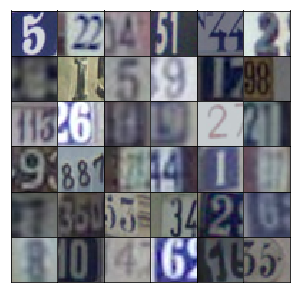

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [27]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=(2, 2), padding='same', use_bias=False)
#         x1 = tf.layers.batch_normalization(x1, training=True) # Avoid Artifacts
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides=(2, 2), padding='same', use_bias=False)
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=(2, 2), padding='same', use_bias=False)
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        
        flat = tf.reshape(x3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [28]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [29]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [30]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [31]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [32]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time. (-log(0.5) = 0.3)

In [33]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 20
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/20... Discriminator Loss: 1.7381... Generator Loss: 0.4554
Epoch 1/20... Discriminator Loss: 0.4102... Generator Loss: 1.7294
Epoch 1/20... Discriminator Loss: 0.1644... Generator Loss: 2.7488
Epoch 1/20... Discriminator Loss: 0.1629... Generator Loss: 2.4151
Epoch 1/20... Discriminator Loss: 0.1607... Generator Loss: 2.7560
Epoch 1/20... Discriminator Loss: 0.0753... Generator Loss: 3.3196
Epoch 1/20... Discriminator Loss: 0.0963... Generator Loss: 3.1290
Epoch 1/20... Discriminator Loss: 0.1296... Generator Loss: 3.0885
Epoch 1/20... Discriminator Loss: 0.2220... Generator Loss: 3.8395
Epoch 1/20... Discriminator Loss: 0.0932... Generator Loss: 4.0770


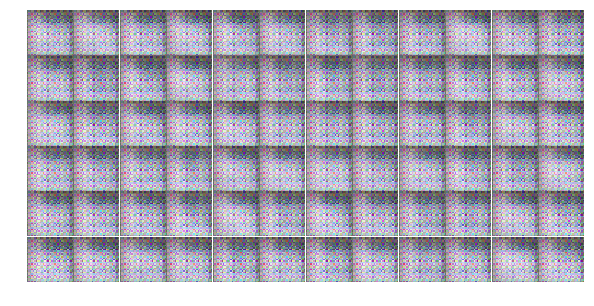

Epoch 1/20... Discriminator Loss: 0.1292... Generator Loss: 2.9766
Epoch 1/20... Discriminator Loss: 0.8418... Generator Loss: 3.3086
Epoch 1/20... Discriminator Loss: 0.8333... Generator Loss: 1.4740
Epoch 1/20... Discriminator Loss: 0.6464... Generator Loss: 1.4353
Epoch 1/20... Discriminator Loss: 0.6312... Generator Loss: 1.6401
Epoch 1/20... Discriminator Loss: 0.6293... Generator Loss: 1.7482
Epoch 1/20... Discriminator Loss: 0.5875... Generator Loss: 1.7140
Epoch 1/20... Discriminator Loss: 0.5150... Generator Loss: 1.5339
Epoch 1/20... Discriminator Loss: 0.5691... Generator Loss: 1.2993
Epoch 1/20... Discriminator Loss: 0.2546... Generator Loss: 2.6219


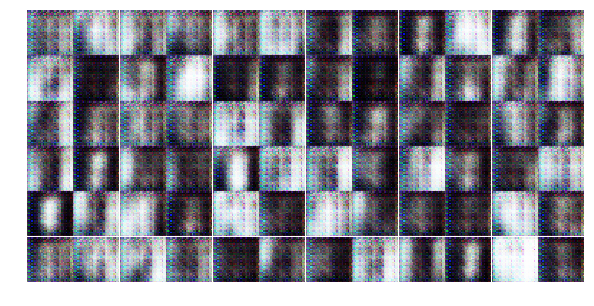

Epoch 1/20... Discriminator Loss: 0.4499... Generator Loss: 2.6265
Epoch 1/20... Discriminator Loss: 0.3954... Generator Loss: 2.4917
Epoch 1/20... Discriminator Loss: 0.4515... Generator Loss: 2.3885
Epoch 1/20... Discriminator Loss: 0.3935... Generator Loss: 2.9716
Epoch 1/20... Discriminator Loss: 0.4504... Generator Loss: 2.2679
Epoch 1/20... Discriminator Loss: 0.9433... Generator Loss: 1.3197
Epoch 1/20... Discriminator Loss: 0.5879... Generator Loss: 1.2973
Epoch 1/20... Discriminator Loss: 0.3081... Generator Loss: 2.2044
Epoch 1/20... Discriminator Loss: 0.3819... Generator Loss: 2.8336
Epoch 1/20... Discriminator Loss: 0.4582... Generator Loss: 2.2302


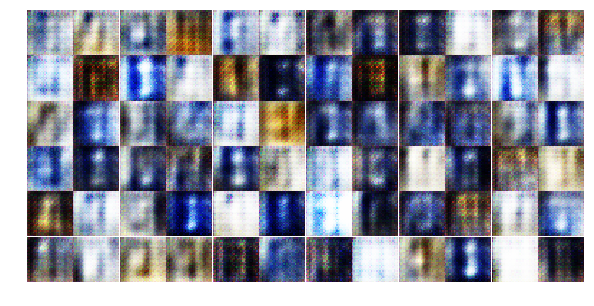

Epoch 1/20... Discriminator Loss: 0.6763... Generator Loss: 2.2523
Epoch 1/20... Discriminator Loss: 1.1444... Generator Loss: 0.5775
Epoch 1/20... Discriminator Loss: 0.5778... Generator Loss: 1.8187
Epoch 1/20... Discriminator Loss: 0.5770... Generator Loss: 1.9265
Epoch 1/20... Discriminator Loss: 0.6876... Generator Loss: 1.5223
Epoch 1/20... Discriminator Loss: 1.1206... Generator Loss: 3.4446
Epoch 1/20... Discriminator Loss: 0.9525... Generator Loss: 0.7480
Epoch 1/20... Discriminator Loss: 0.4359... Generator Loss: 2.4938
Epoch 1/20... Discriminator Loss: 0.5767... Generator Loss: 2.4087
Epoch 1/20... Discriminator Loss: 0.7186... Generator Loss: 1.3370


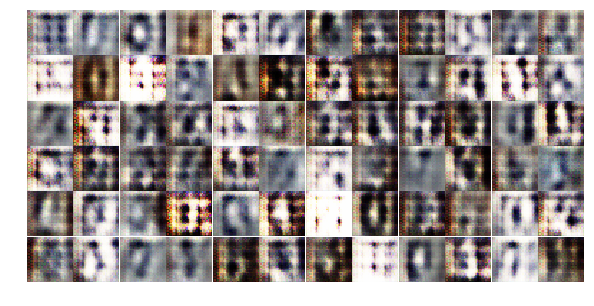

Epoch 1/20... Discriminator Loss: 0.4758... Generator Loss: 2.3361
Epoch 1/20... Discriminator Loss: 0.4779... Generator Loss: 1.8066
Epoch 1/20... Discriminator Loss: 0.7608... Generator Loss: 1.6591
Epoch 1/20... Discriminator Loss: 0.6967... Generator Loss: 1.7797
Epoch 1/20... Discriminator Loss: 0.6621... Generator Loss: 1.0960
Epoch 1/20... Discriminator Loss: 0.7708... Generator Loss: 2.9188
Epoch 1/20... Discriminator Loss: 1.3341... Generator Loss: 0.9501
Epoch 1/20... Discriminator Loss: 0.4185... Generator Loss: 2.4242
Epoch 1/20... Discriminator Loss: 0.8362... Generator Loss: 1.1056
Epoch 1/20... Discriminator Loss: 1.1667... Generator Loss: 2.2886


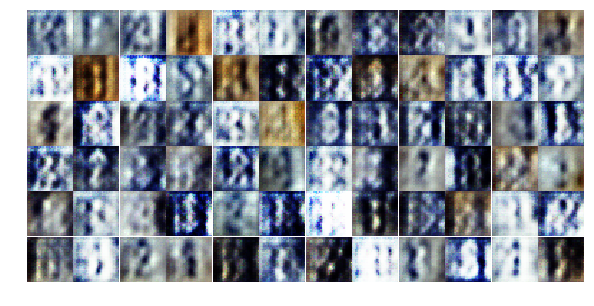

Epoch 1/20... Discriminator Loss: 0.7341... Generator Loss: 1.0957
Epoch 1/20... Discriminator Loss: 0.6867... Generator Loss: 1.6436
Epoch 1/20... Discriminator Loss: 0.4539... Generator Loss: 1.7773
Epoch 1/20... Discriminator Loss: 0.7917... Generator Loss: 1.2104
Epoch 1/20... Discriminator Loss: 0.9218... Generator Loss: 1.5042
Epoch 1/20... Discriminator Loss: 0.5312... Generator Loss: 1.5862
Epoch 1/20... Discriminator Loss: 0.9899... Generator Loss: 2.6030
Epoch 2/20... Discriminator Loss: 0.9167... Generator Loss: 1.5523
Epoch 2/20... Discriminator Loss: 0.9332... Generator Loss: 2.4233
Epoch 2/20... Discriminator Loss: 0.7757... Generator Loss: 1.2023


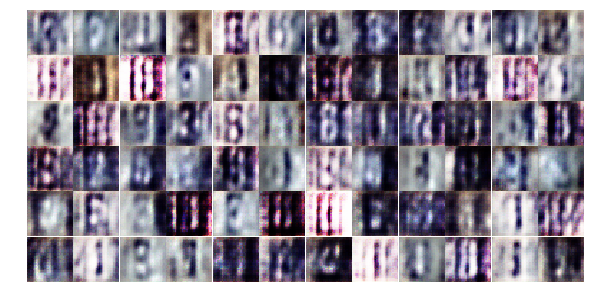

Epoch 2/20... Discriminator Loss: 0.8060... Generator Loss: 1.0812
Epoch 2/20... Discriminator Loss: 1.2132... Generator Loss: 0.6700
Epoch 2/20... Discriminator Loss: 1.1028... Generator Loss: 1.2839
Epoch 2/20... Discriminator Loss: 1.0846... Generator Loss: 0.8416
Epoch 2/20... Discriminator Loss: 1.0061... Generator Loss: 1.3853
Epoch 2/20... Discriminator Loss: 1.2430... Generator Loss: 0.5985
Epoch 2/20... Discriminator Loss: 0.9129... Generator Loss: 1.5048
Epoch 2/20... Discriminator Loss: 1.3734... Generator Loss: 0.8344
Epoch 2/20... Discriminator Loss: 1.7355... Generator Loss: 0.8583
Epoch 2/20... Discriminator Loss: 1.7494... Generator Loss: 1.4055


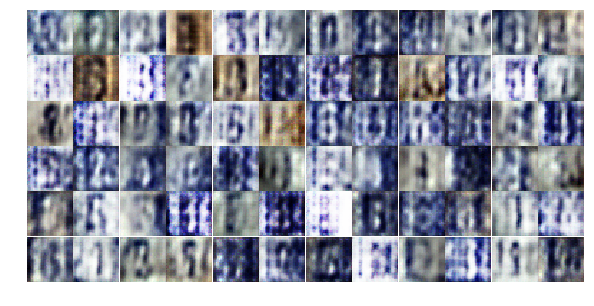

Epoch 2/20... Discriminator Loss: 1.4264... Generator Loss: 1.0378
Epoch 2/20... Discriminator Loss: 0.6297... Generator Loss: 1.6840
Epoch 2/20... Discriminator Loss: 0.6583... Generator Loss: 2.1552
Epoch 2/20... Discriminator Loss: 0.7018... Generator Loss: 1.3306
Epoch 2/20... Discriminator Loss: 1.5125... Generator Loss: 1.2975
Epoch 2/20... Discriminator Loss: 0.7437... Generator Loss: 1.2089
Epoch 2/20... Discriminator Loss: 0.9094... Generator Loss: 0.9555
Epoch 2/20... Discriminator Loss: 0.8138... Generator Loss: 1.1556
Epoch 2/20... Discriminator Loss: 0.5610... Generator Loss: 1.6084
Epoch 2/20... Discriminator Loss: 1.7882... Generator Loss: 0.3169


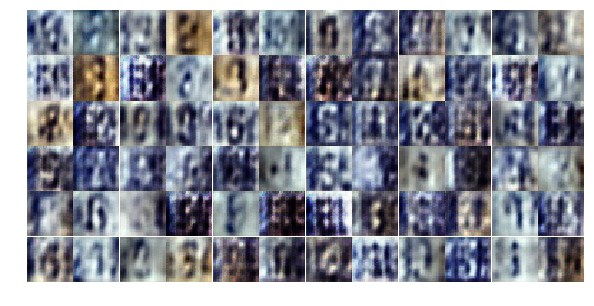

Epoch 2/20... Discriminator Loss: 1.6807... Generator Loss: 0.3528
Epoch 2/20... Discriminator Loss: 1.3690... Generator Loss: 2.4837
Epoch 2/20... Discriminator Loss: 0.8673... Generator Loss: 1.2564
Epoch 2/20... Discriminator Loss: 1.0378... Generator Loss: 0.8737
Epoch 2/20... Discriminator Loss: 1.1762... Generator Loss: 1.4336
Epoch 2/20... Discriminator Loss: 0.9093... Generator Loss: 1.0284
Epoch 2/20... Discriminator Loss: 1.7830... Generator Loss: 0.2707
Epoch 2/20... Discriminator Loss: 1.0834... Generator Loss: 0.6389
Epoch 2/20... Discriminator Loss: 0.9018... Generator Loss: 1.6009
Epoch 2/20... Discriminator Loss: 0.8802... Generator Loss: 0.8705


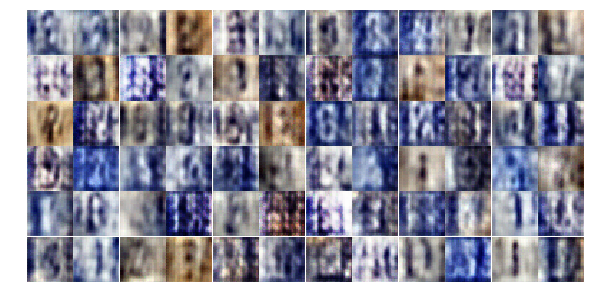

Epoch 2/20... Discriminator Loss: 0.7632... Generator Loss: 1.6377
Epoch 2/20... Discriminator Loss: 0.8288... Generator Loss: 1.8122
Epoch 2/20... Discriminator Loss: 1.7263... Generator Loss: 0.5375
Epoch 2/20... Discriminator Loss: 0.9577... Generator Loss: 0.9317
Epoch 2/20... Discriminator Loss: 0.6963... Generator Loss: 1.4698
Epoch 2/20... Discriminator Loss: 1.2396... Generator Loss: 1.0736
Epoch 2/20... Discriminator Loss: 1.0105... Generator Loss: 1.2471
Epoch 2/20... Discriminator Loss: 1.0885... Generator Loss: 1.1274
Epoch 2/20... Discriminator Loss: 1.0290... Generator Loss: 1.1313
Epoch 2/20... Discriminator Loss: 1.1885... Generator Loss: 0.6602


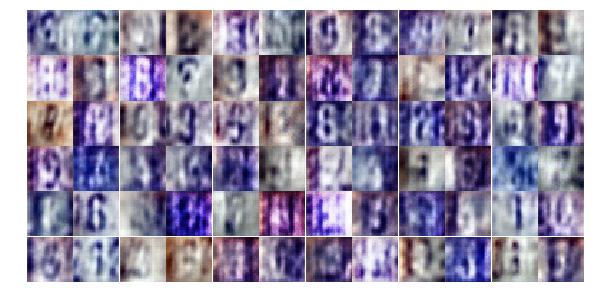

Epoch 2/20... Discriminator Loss: 0.7473... Generator Loss: 1.4237
Epoch 2/20... Discriminator Loss: 1.3914... Generator Loss: 0.9933
Epoch 2/20... Discriminator Loss: 0.9767... Generator Loss: 1.2704
Epoch 2/20... Discriminator Loss: 1.0845... Generator Loss: 1.0490
Epoch 2/20... Discriminator Loss: 0.7923... Generator Loss: 1.1961
Epoch 2/20... Discriminator Loss: 1.0472... Generator Loss: 1.1592
Epoch 2/20... Discriminator Loss: 0.6597... Generator Loss: 1.3849
Epoch 2/20... Discriminator Loss: 0.8471... Generator Loss: 1.6907
Epoch 2/20... Discriminator Loss: 0.7821... Generator Loss: 1.1491
Epoch 2/20... Discriminator Loss: 0.8582... Generator Loss: 1.4605


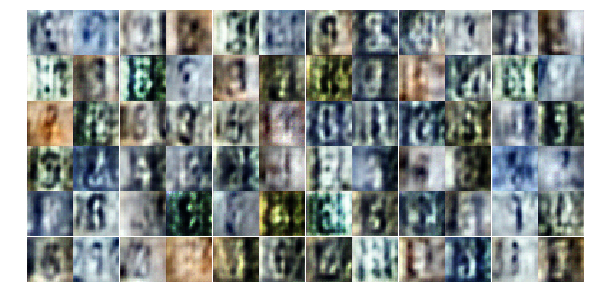

Epoch 2/20... Discriminator Loss: 0.9452... Generator Loss: 1.2978
Epoch 2/20... Discriminator Loss: 0.6729... Generator Loss: 2.0435
Epoch 2/20... Discriminator Loss: 1.1809... Generator Loss: 1.1521
Epoch 2/20... Discriminator Loss: 1.2645... Generator Loss: 0.5824
Epoch 3/20... Discriminator Loss: 1.0800... Generator Loss: 2.2730
Epoch 3/20... Discriminator Loss: 0.9134... Generator Loss: 1.1884
Epoch 3/20... Discriminator Loss: 0.8532... Generator Loss: 1.4952
Epoch 3/20... Discriminator Loss: 0.6442... Generator Loss: 1.6198
Epoch 3/20... Discriminator Loss: 0.7040... Generator Loss: 1.3895
Epoch 3/20... Discriminator Loss: 0.9573... Generator Loss: 0.8990


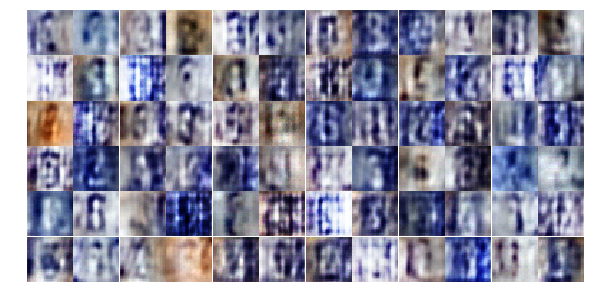

Epoch 3/20... Discriminator Loss: 0.5788... Generator Loss: 1.9975
Epoch 3/20... Discriminator Loss: 0.9041... Generator Loss: 1.3541
Epoch 3/20... Discriminator Loss: 0.7310... Generator Loss: 1.7813
Epoch 3/20... Discriminator Loss: 0.6689... Generator Loss: 1.0700
Epoch 3/20... Discriminator Loss: 0.4380... Generator Loss: 1.9782
Epoch 3/20... Discriminator Loss: 1.3078... Generator Loss: 0.9309
Epoch 3/20... Discriminator Loss: 0.9224... Generator Loss: 0.9740
Epoch 3/20... Discriminator Loss: 0.8309... Generator Loss: 1.5607
Epoch 3/20... Discriminator Loss: 0.7506... Generator Loss: 1.5597
Epoch 3/20... Discriminator Loss: 0.6230... Generator Loss: 1.2312


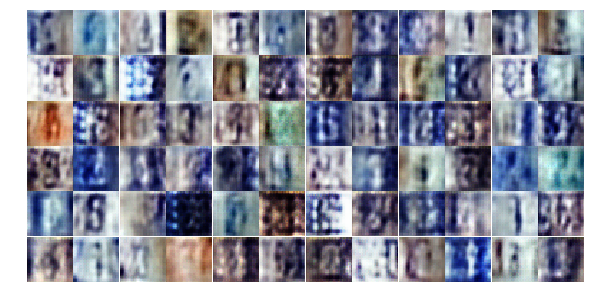

Epoch 3/20... Discriminator Loss: 0.7146... Generator Loss: 1.3107
Epoch 3/20... Discriminator Loss: 0.8010... Generator Loss: 1.1456
Epoch 3/20... Discriminator Loss: 1.0436... Generator Loss: 0.7192
Epoch 3/20... Discriminator Loss: 0.9109... Generator Loss: 1.4309
Epoch 3/20... Discriminator Loss: 0.5902... Generator Loss: 1.4157
Epoch 3/20... Discriminator Loss: 0.4812... Generator Loss: 1.7654
Epoch 3/20... Discriminator Loss: 1.7407... Generator Loss: 0.2780
Epoch 3/20... Discriminator Loss: 0.7732... Generator Loss: 1.3569
Epoch 3/20... Discriminator Loss: 0.5984... Generator Loss: 2.2755
Epoch 3/20... Discriminator Loss: 0.4644... Generator Loss: 1.4809


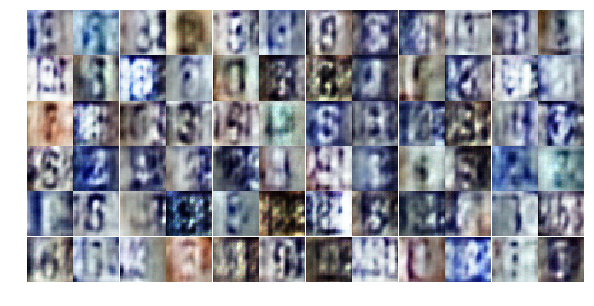

Epoch 3/20... Discriminator Loss: 0.7767... Generator Loss: 1.5506
Epoch 3/20... Discriminator Loss: 0.7763... Generator Loss: 2.5883
Epoch 3/20... Discriminator Loss: 0.8367... Generator Loss: 1.0386
Epoch 3/20... Discriminator Loss: 0.6278... Generator Loss: 2.0594
Epoch 3/20... Discriminator Loss: 0.6099... Generator Loss: 1.5987
Epoch 3/20... Discriminator Loss: 0.8662... Generator Loss: 1.2527
Epoch 3/20... Discriminator Loss: 0.9319... Generator Loss: 1.0721
Epoch 3/20... Discriminator Loss: 0.9427... Generator Loss: 0.8141
Epoch 3/20... Discriminator Loss: 0.6212... Generator Loss: 1.3481
Epoch 3/20... Discriminator Loss: 0.4140... Generator Loss: 1.9921


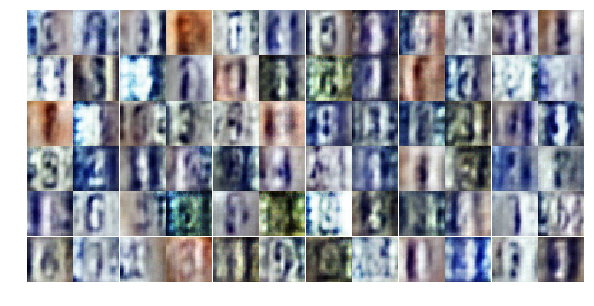

Epoch 3/20... Discriminator Loss: 0.6802... Generator Loss: 2.7995
Epoch 3/20... Discriminator Loss: 0.2519... Generator Loss: 2.8743
Epoch 3/20... Discriminator Loss: 0.9259... Generator Loss: 0.8066
Epoch 3/20... Discriminator Loss: 0.9658... Generator Loss: 0.7908
Epoch 3/20... Discriminator Loss: 0.6222... Generator Loss: 2.7895
Epoch 3/20... Discriminator Loss: 0.4531... Generator Loss: 1.4998
Epoch 3/20... Discriminator Loss: 1.0757... Generator Loss: 0.8814
Epoch 3/20... Discriminator Loss: 1.1186... Generator Loss: 0.6664
Epoch 3/20... Discriminator Loss: 0.9039... Generator Loss: 2.2135
Epoch 3/20... Discriminator Loss: 0.8532... Generator Loss: 1.1383


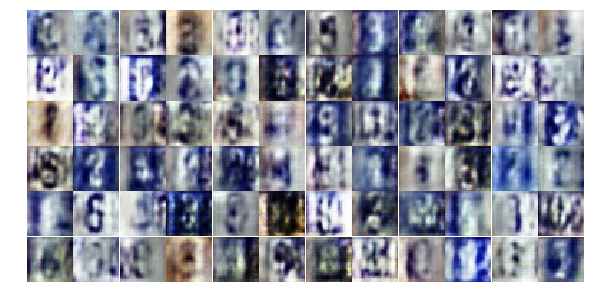

Epoch 3/20... Discriminator Loss: 0.9763... Generator Loss: 0.8599
Epoch 3/20... Discriminator Loss: 0.8348... Generator Loss: 2.4332
Epoch 3/20... Discriminator Loss: 0.9491... Generator Loss: 0.9157
Epoch 3/20... Discriminator Loss: 0.7275... Generator Loss: 1.3781
Epoch 3/20... Discriminator Loss: 0.4719... Generator Loss: 2.0539
Epoch 3/20... Discriminator Loss: 0.4211... Generator Loss: 1.9324
Epoch 3/20... Discriminator Loss: 0.5516... Generator Loss: 1.4408
Epoch 3/20... Discriminator Loss: 0.6433... Generator Loss: 2.1058
Epoch 3/20... Discriminator Loss: 0.8179... Generator Loss: 1.3346
Epoch 3/20... Discriminator Loss: 0.7223... Generator Loss: 2.3863


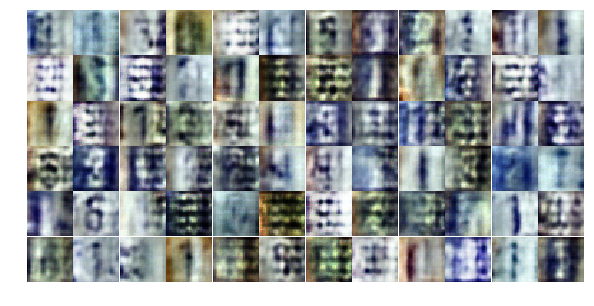

Epoch 3/20... Discriminator Loss: 1.2755... Generator Loss: 0.5047
Epoch 4/20... Discriminator Loss: 0.3441... Generator Loss: 1.9706
Epoch 4/20... Discriminator Loss: 0.4322... Generator Loss: 1.9516
Epoch 4/20... Discriminator Loss: 0.9284... Generator Loss: 0.8320
Epoch 4/20... Discriminator Loss: 0.6366... Generator Loss: 1.3943
Epoch 4/20... Discriminator Loss: 0.6182... Generator Loss: 1.1672
Epoch 4/20... Discriminator Loss: 0.5566... Generator Loss: 2.6221
Epoch 4/20... Discriminator Loss: 1.0233... Generator Loss: 0.7744
Epoch 4/20... Discriminator Loss: 0.6337... Generator Loss: 1.1052
Epoch 4/20... Discriminator Loss: 0.7692... Generator Loss: 0.9787


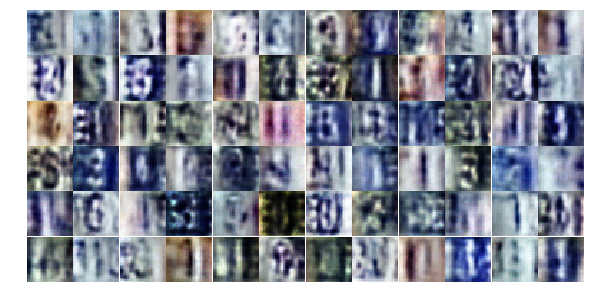

Epoch 4/20... Discriminator Loss: 0.7502... Generator Loss: 0.9444
Epoch 4/20... Discriminator Loss: 0.7014... Generator Loss: 1.3168
Epoch 4/20... Discriminator Loss: 0.8533... Generator Loss: 1.2676
Epoch 4/20... Discriminator Loss: 1.3664... Generator Loss: 0.7005
Epoch 4/20... Discriminator Loss: 0.6793... Generator Loss: 1.9206
Epoch 4/20... Discriminator Loss: 1.3381... Generator Loss: 0.4837
Epoch 4/20... Discriminator Loss: 0.7211... Generator Loss: 1.1099
Epoch 4/20... Discriminator Loss: 0.5398... Generator Loss: 1.5721
Epoch 4/20... Discriminator Loss: 1.1301... Generator Loss: 0.7982
Epoch 4/20... Discriminator Loss: 0.6551... Generator Loss: 1.1525


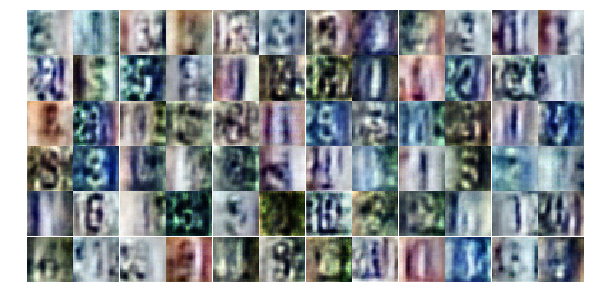

Epoch 4/20... Discriminator Loss: 0.8878... Generator Loss: 0.7643
Epoch 4/20... Discriminator Loss: 0.7455... Generator Loss: 2.0115
Epoch 4/20... Discriminator Loss: 1.0488... Generator Loss: 0.7150
Epoch 4/20... Discriminator Loss: 0.5980... Generator Loss: 1.4959
Epoch 4/20... Discriminator Loss: 0.6412... Generator Loss: 2.5837
Epoch 4/20... Discriminator Loss: 0.3717... Generator Loss: 2.2188
Epoch 4/20... Discriminator Loss: 0.9629... Generator Loss: 0.6829
Epoch 4/20... Discriminator Loss: 0.8550... Generator Loss: 0.7954
Epoch 4/20... Discriminator Loss: 0.6359... Generator Loss: 1.3876
Epoch 4/20... Discriminator Loss: 0.7211... Generator Loss: 1.4500


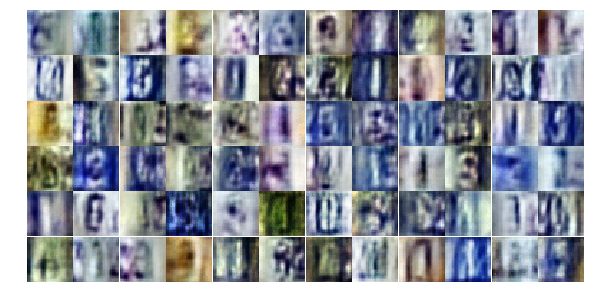

Epoch 4/20... Discriminator Loss: 0.5379... Generator Loss: 1.4456
Epoch 4/20... Discriminator Loss: 0.7673... Generator Loss: 0.9714
Epoch 4/20... Discriminator Loss: 0.5213... Generator Loss: 1.7937
Epoch 4/20... Discriminator Loss: 0.5220... Generator Loss: 1.5573
Epoch 4/20... Discriminator Loss: 0.4058... Generator Loss: 1.9697
Epoch 4/20... Discriminator Loss: 0.5434... Generator Loss: 1.7397
Epoch 4/20... Discriminator Loss: 0.6039... Generator Loss: 1.2103
Epoch 4/20... Discriminator Loss: 0.3656... Generator Loss: 1.7290
Epoch 4/20... Discriminator Loss: 0.5064... Generator Loss: 1.6529
Epoch 4/20... Discriminator Loss: 0.9365... Generator Loss: 0.7684


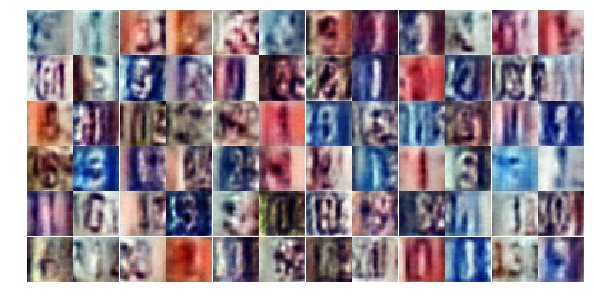

Epoch 4/20... Discriminator Loss: 0.8863... Generator Loss: 0.7897
Epoch 4/20... Discriminator Loss: 0.7648... Generator Loss: 0.9176
Epoch 4/20... Discriminator Loss: 0.6236... Generator Loss: 1.3571
Epoch 4/20... Discriminator Loss: 0.5339... Generator Loss: 1.3760
Epoch 4/20... Discriminator Loss: 0.4914... Generator Loss: 1.4157
Epoch 4/20... Discriminator Loss: 0.5935... Generator Loss: 1.3902
Epoch 4/20... Discriminator Loss: 0.4486... Generator Loss: 2.4742
Epoch 4/20... Discriminator Loss: 0.9027... Generator Loss: 0.8606
Epoch 4/20... Discriminator Loss: 0.5342... Generator Loss: 1.6301
Epoch 4/20... Discriminator Loss: 0.5938... Generator Loss: 1.5487


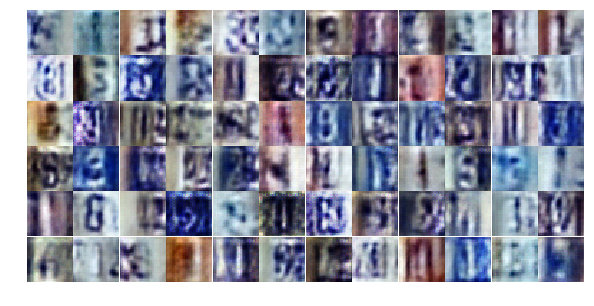

Epoch 4/20... Discriminator Loss: 1.0282... Generator Loss: 0.7622
Epoch 4/20... Discriminator Loss: 0.7391... Generator Loss: 1.1201
Epoch 4/20... Discriminator Loss: 0.4749... Generator Loss: 2.0337
Epoch 4/20... Discriminator Loss: 0.6111... Generator Loss: 1.7856
Epoch 4/20... Discriminator Loss: 0.6405... Generator Loss: 1.2387
Epoch 4/20... Discriminator Loss: 0.4865... Generator Loss: 1.8922
Epoch 4/20... Discriminator Loss: 0.4543... Generator Loss: 1.4479
Epoch 4/20... Discriminator Loss: 0.9329... Generator Loss: 0.7373
Epoch 4/20... Discriminator Loss: 0.8154... Generator Loss: 2.5381
Epoch 5/20... Discriminator Loss: 1.2194... Generator Loss: 0.4543


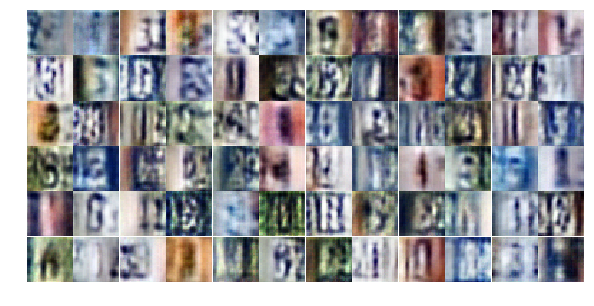

Epoch 5/20... Discriminator Loss: 0.4975... Generator Loss: 1.8067
Epoch 5/20... Discriminator Loss: 0.6220... Generator Loss: 1.1741
Epoch 5/20... Discriminator Loss: 0.6786... Generator Loss: 1.1091
Epoch 5/20... Discriminator Loss: 0.5604... Generator Loss: 1.2474
Epoch 5/20... Discriminator Loss: 0.3119... Generator Loss: 2.4720
Epoch 5/20... Discriminator Loss: 0.5625... Generator Loss: 2.1253
Epoch 5/20... Discriminator Loss: 0.7676... Generator Loss: 2.2051
Epoch 5/20... Discriminator Loss: 0.4425... Generator Loss: 1.8918
Epoch 5/20... Discriminator Loss: 1.1654... Generator Loss: 0.5210
Epoch 5/20... Discriminator Loss: 0.8235... Generator Loss: 1.3442


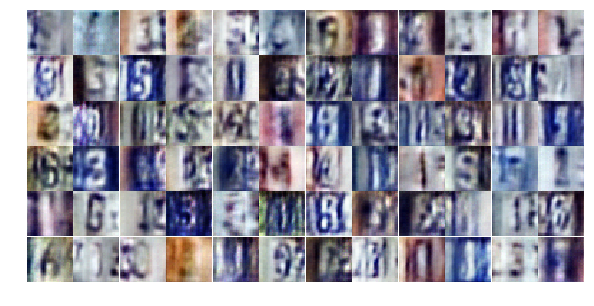

Epoch 5/20... Discriminator Loss: 0.5359... Generator Loss: 1.8437
Epoch 5/20... Discriminator Loss: 0.5209... Generator Loss: 2.2402
Epoch 5/20... Discriminator Loss: 0.4154... Generator Loss: 1.6870
Epoch 5/20... Discriminator Loss: 0.8035... Generator Loss: 0.8691
Epoch 5/20... Discriminator Loss: 0.6781... Generator Loss: 2.0596
Epoch 5/20... Discriminator Loss: 1.0310... Generator Loss: 0.7049
Epoch 5/20... Discriminator Loss: 0.7242... Generator Loss: 1.0526
Epoch 5/20... Discriminator Loss: 0.5722... Generator Loss: 1.3436
Epoch 5/20... Discriminator Loss: 0.5232... Generator Loss: 1.5441
Epoch 5/20... Discriminator Loss: 0.9113... Generator Loss: 0.7516


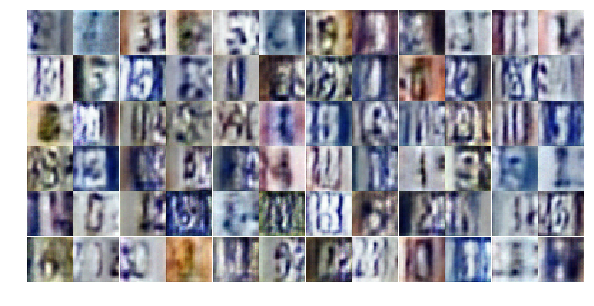

Epoch 5/20... Discriminator Loss: 0.6934... Generator Loss: 1.0974
Epoch 5/20... Discriminator Loss: 1.5121... Generator Loss: 0.4534
Epoch 5/20... Discriminator Loss: 0.5690... Generator Loss: 1.2947
Epoch 5/20... Discriminator Loss: 0.4308... Generator Loss: 1.7835
Epoch 5/20... Discriminator Loss: 0.8851... Generator Loss: 0.7765
Epoch 5/20... Discriminator Loss: 0.5396... Generator Loss: 1.3436
Epoch 5/20... Discriminator Loss: 0.7115... Generator Loss: 0.9789
Epoch 5/20... Discriminator Loss: 0.6495... Generator Loss: 1.2366
Epoch 5/20... Discriminator Loss: 0.9915... Generator Loss: 1.3984
Epoch 5/20... Discriminator Loss: 0.4667... Generator Loss: 1.4946


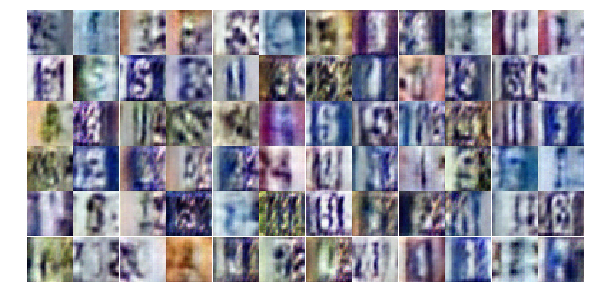

Epoch 5/20... Discriminator Loss: 0.6979... Generator Loss: 1.9815
Epoch 5/20... Discriminator Loss: 0.6079... Generator Loss: 1.2599
Epoch 5/20... Discriminator Loss: 0.5601... Generator Loss: 1.8454
Epoch 5/20... Discriminator Loss: 0.6514... Generator Loss: 1.1161
Epoch 5/20... Discriminator Loss: 0.5738... Generator Loss: 1.5377
Epoch 5/20... Discriminator Loss: 0.5316... Generator Loss: 1.6952
Epoch 5/20... Discriminator Loss: 1.3724... Generator Loss: 0.4115
Epoch 5/20... Discriminator Loss: 1.3338... Generator Loss: 0.5413
Epoch 5/20... Discriminator Loss: 1.0643... Generator Loss: 0.5945
Epoch 5/20... Discriminator Loss: 0.9503... Generator Loss: 0.7314


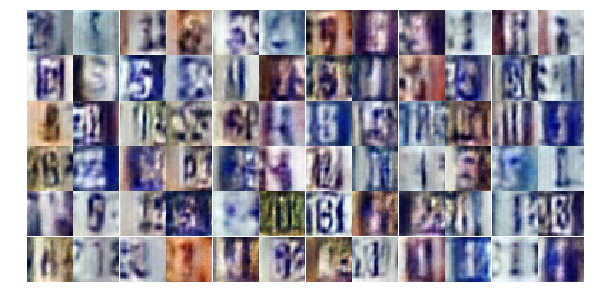

Epoch 5/20... Discriminator Loss: 0.6064... Generator Loss: 1.6206
Epoch 5/20... Discriminator Loss: 0.6842... Generator Loss: 1.0048
Epoch 5/20... Discriminator Loss: 1.4466... Generator Loss: 0.3810
Epoch 5/20... Discriminator Loss: 0.6830... Generator Loss: 1.4519
Epoch 5/20... Discriminator Loss: 0.7107... Generator Loss: 1.4885
Epoch 5/20... Discriminator Loss: 0.9093... Generator Loss: 0.8653
Epoch 5/20... Discriminator Loss: 0.7107... Generator Loss: 1.3513
Epoch 5/20... Discriminator Loss: 0.6150... Generator Loss: 1.4068
Epoch 5/20... Discriminator Loss: 0.7595... Generator Loss: 0.8271
Epoch 5/20... Discriminator Loss: 0.6276... Generator Loss: 1.4167


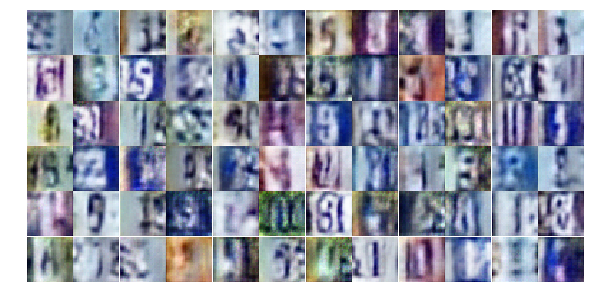

Epoch 5/20... Discriminator Loss: 0.6852... Generator Loss: 1.1458
Epoch 5/20... Discriminator Loss: 0.8524... Generator Loss: 0.7603
Epoch 5/20... Discriminator Loss: 1.6858... Generator Loss: 3.5968
Epoch 5/20... Discriminator Loss: 0.9318... Generator Loss: 0.8245
Epoch 5/20... Discriminator Loss: 0.7635... Generator Loss: 1.0432
Epoch 5/20... Discriminator Loss: 0.9388... Generator Loss: 0.8276
Epoch 6/20... Discriminator Loss: 0.6464... Generator Loss: 1.3126
Epoch 6/20... Discriminator Loss: 0.5167... Generator Loss: 1.5319
Epoch 6/20... Discriminator Loss: 0.8648... Generator Loss: 0.8639
Epoch 6/20... Discriminator Loss: 1.1458... Generator Loss: 0.5641


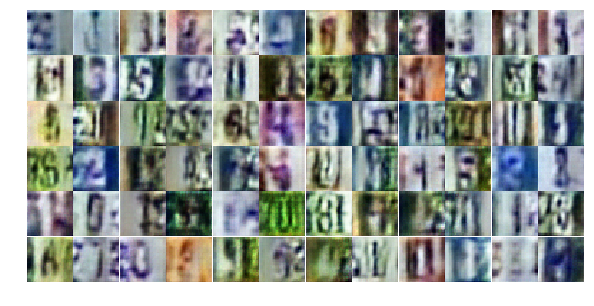

Epoch 6/20... Discriminator Loss: 0.9563... Generator Loss: 0.6937
Epoch 6/20... Discriminator Loss: 0.8316... Generator Loss: 1.0021
Epoch 6/20... Discriminator Loss: 0.9291... Generator Loss: 2.3347
Epoch 6/20... Discriminator Loss: 1.0904... Generator Loss: 0.7820
Epoch 6/20... Discriminator Loss: 0.9809... Generator Loss: 0.7561
Epoch 6/20... Discriminator Loss: 0.8934... Generator Loss: 0.7324
Epoch 6/20... Discriminator Loss: 0.5658... Generator Loss: 1.4048
Epoch 6/20... Discriminator Loss: 0.9891... Generator Loss: 0.6947
Epoch 6/20... Discriminator Loss: 0.4502... Generator Loss: 1.4618
Epoch 6/20... Discriminator Loss: 0.9204... Generator Loss: 2.7421


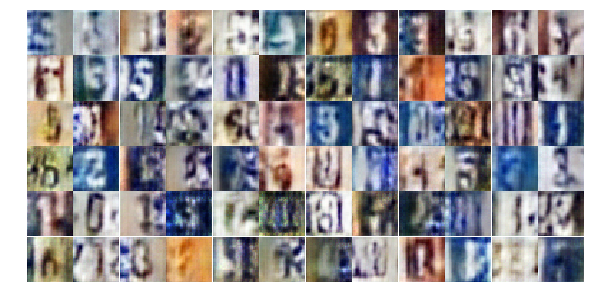

Epoch 6/20... Discriminator Loss: 1.3469... Generator Loss: 2.6756
Epoch 6/20... Discriminator Loss: 0.5762... Generator Loss: 1.4722
Epoch 6/20... Discriminator Loss: 1.2479... Generator Loss: 0.4639
Epoch 6/20... Discriminator Loss: 0.5566... Generator Loss: 1.2370
Epoch 6/20... Discriminator Loss: 0.5484... Generator Loss: 2.3441
Epoch 6/20... Discriminator Loss: 0.8411... Generator Loss: 0.9342
Epoch 6/20... Discriminator Loss: 0.7066... Generator Loss: 1.1060
Epoch 6/20... Discriminator Loss: 0.8141... Generator Loss: 1.3005
Epoch 6/20... Discriminator Loss: 0.8166... Generator Loss: 1.5800
Epoch 6/20... Discriminator Loss: 0.6510... Generator Loss: 1.2006


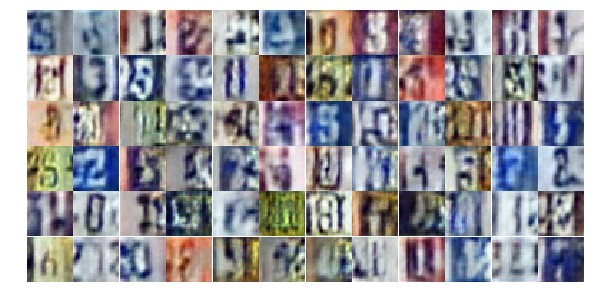

Epoch 6/20... Discriminator Loss: 1.0562... Generator Loss: 0.6105
Epoch 6/20... Discriminator Loss: 0.6017... Generator Loss: 1.3480
Epoch 6/20... Discriminator Loss: 0.6738... Generator Loss: 1.5198
Epoch 6/20... Discriminator Loss: 1.0411... Generator Loss: 0.5878
Epoch 6/20... Discriminator Loss: 0.7036... Generator Loss: 2.2068
Epoch 6/20... Discriminator Loss: 1.0626... Generator Loss: 0.6314
Epoch 6/20... Discriminator Loss: 0.7402... Generator Loss: 1.3433
Epoch 6/20... Discriminator Loss: 0.5140... Generator Loss: 1.7508
Epoch 6/20... Discriminator Loss: 0.5891... Generator Loss: 1.3457
Epoch 6/20... Discriminator Loss: 0.5276... Generator Loss: 1.7087


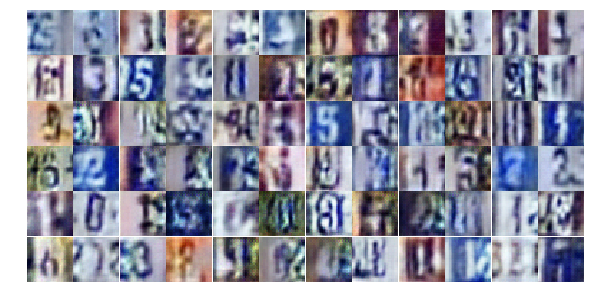

Epoch 6/20... Discriminator Loss: 0.8433... Generator Loss: 0.7594
Epoch 6/20... Discriminator Loss: 0.6673... Generator Loss: 1.9603
Epoch 6/20... Discriminator Loss: 0.7525... Generator Loss: 1.2801
Epoch 6/20... Discriminator Loss: 0.9299... Generator Loss: 0.8141
Epoch 6/20... Discriminator Loss: 0.5018... Generator Loss: 1.4240
Epoch 6/20... Discriminator Loss: 0.9825... Generator Loss: 0.6707
Epoch 6/20... Discriminator Loss: 0.7571... Generator Loss: 1.0215
Epoch 6/20... Discriminator Loss: 0.6847... Generator Loss: 2.2715
Epoch 6/20... Discriminator Loss: 0.6711... Generator Loss: 1.4851
Epoch 6/20... Discriminator Loss: 0.3219... Generator Loss: 1.8885


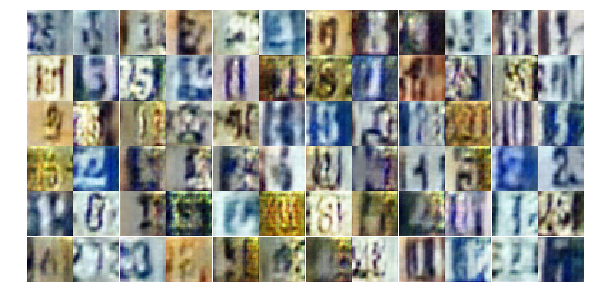

Epoch 6/20... Discriminator Loss: 0.6663... Generator Loss: 1.2520
Epoch 6/20... Discriminator Loss: 0.7672... Generator Loss: 0.9063
Epoch 6/20... Discriminator Loss: 0.9765... Generator Loss: 1.6185
Epoch 6/20... Discriminator Loss: 0.7638... Generator Loss: 1.2387
Epoch 6/20... Discriminator Loss: 0.5357... Generator Loss: 1.5364
Epoch 6/20... Discriminator Loss: 0.5767... Generator Loss: 1.3343
Epoch 6/20... Discriminator Loss: 0.8319... Generator Loss: 0.8672
Epoch 6/20... Discriminator Loss: 1.2695... Generator Loss: 0.4452
Epoch 6/20... Discriminator Loss: 0.7743... Generator Loss: 1.0510
Epoch 6/20... Discriminator Loss: 1.3171... Generator Loss: 0.3956


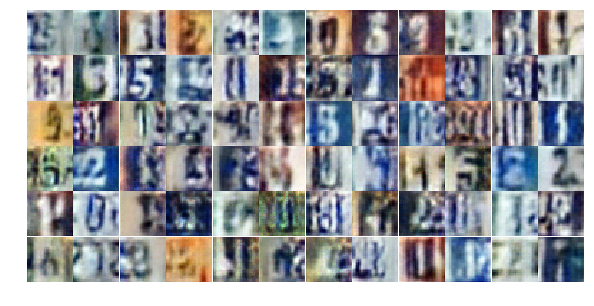

Epoch 6/20... Discriminator Loss: 0.7092... Generator Loss: 1.5826
Epoch 6/20... Discriminator Loss: 0.8617... Generator Loss: 0.7794
Epoch 6/20... Discriminator Loss: 0.8936... Generator Loss: 0.8503
Epoch 7/20... Discriminator Loss: 0.8000... Generator Loss: 2.4224
Epoch 7/20... Discriminator Loss: 0.9430... Generator Loss: 0.7291
Epoch 7/20... Discriminator Loss: 0.7957... Generator Loss: 0.8726
Epoch 7/20... Discriminator Loss: 0.5181... Generator Loss: 1.6890
Epoch 7/20... Discriminator Loss: 0.5833... Generator Loss: 1.2763
Epoch 7/20... Discriminator Loss: 0.4259... Generator Loss: 1.8228
Epoch 7/20... Discriminator Loss: 1.3361... Generator Loss: 0.4326


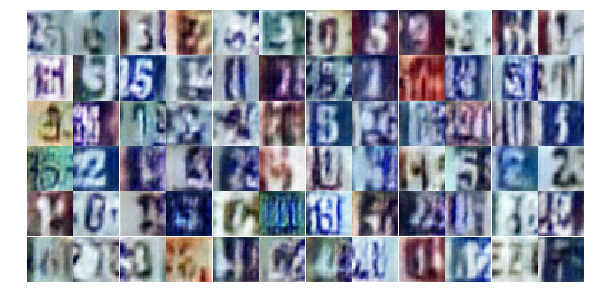

Epoch 7/20... Discriminator Loss: 0.9025... Generator Loss: 2.7284
Epoch 7/20... Discriminator Loss: 1.0034... Generator Loss: 0.6407
Epoch 7/20... Discriminator Loss: 0.8461... Generator Loss: 0.9698
Epoch 7/20... Discriminator Loss: 0.6254... Generator Loss: 1.5141
Epoch 7/20... Discriminator Loss: 0.6277... Generator Loss: 1.3428
Epoch 7/20... Discriminator Loss: 0.6645... Generator Loss: 1.0291
Epoch 7/20... Discriminator Loss: 0.5594... Generator Loss: 1.4576
Epoch 7/20... Discriminator Loss: 0.9320... Generator Loss: 0.7537
Epoch 7/20... Discriminator Loss: 1.6261... Generator Loss: 3.1273
Epoch 7/20... Discriminator Loss: 0.6022... Generator Loss: 1.2818


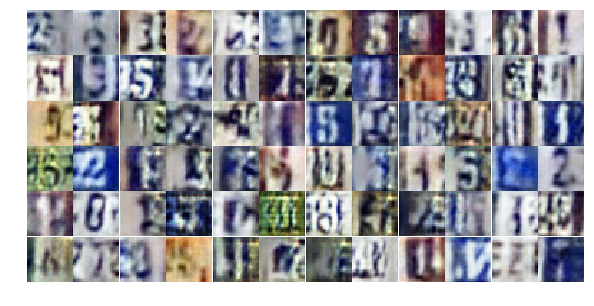

Epoch 7/20... Discriminator Loss: 0.8200... Generator Loss: 0.9912
Epoch 7/20... Discriminator Loss: 0.5008... Generator Loss: 1.6270
Epoch 7/20... Discriminator Loss: 1.1813... Generator Loss: 0.4915
Epoch 7/20... Discriminator Loss: 0.7490... Generator Loss: 1.1219
Epoch 7/20... Discriminator Loss: 0.7032... Generator Loss: 1.1370
Epoch 7/20... Discriminator Loss: 1.9287... Generator Loss: 4.4043
Epoch 7/20... Discriminator Loss: 0.9605... Generator Loss: 0.8172
Epoch 7/20... Discriminator Loss: 0.8230... Generator Loss: 0.9013
Epoch 7/20... Discriminator Loss: 0.4978... Generator Loss: 1.7788
Epoch 7/20... Discriminator Loss: 0.6420... Generator Loss: 1.1109


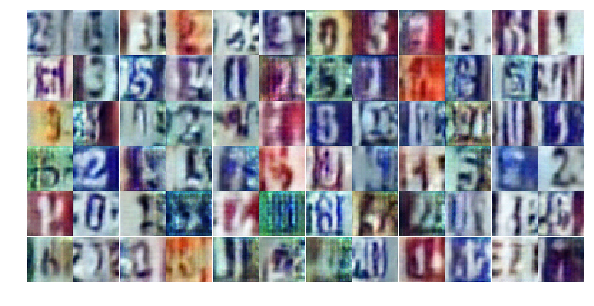

Epoch 7/20... Discriminator Loss: 0.8043... Generator Loss: 0.8896
Epoch 7/20... Discriminator Loss: 0.7819... Generator Loss: 1.0741
Epoch 7/20... Discriminator Loss: 0.9360... Generator Loss: 0.6837
Epoch 7/20... Discriminator Loss: 0.7063... Generator Loss: 1.4591
Epoch 7/20... Discriminator Loss: 0.6503... Generator Loss: 1.2731
Epoch 7/20... Discriminator Loss: 0.9086... Generator Loss: 0.7421
Epoch 7/20... Discriminator Loss: 0.7297... Generator Loss: 0.9791
Epoch 7/20... Discriminator Loss: 0.4315... Generator Loss: 1.7806
Epoch 7/20... Discriminator Loss: 1.0003... Generator Loss: 0.6654
Epoch 7/20... Discriminator Loss: 0.5836... Generator Loss: 1.6978


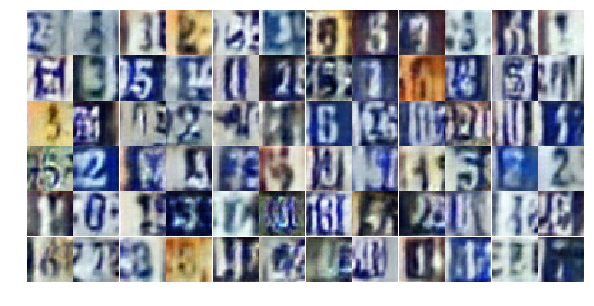

Epoch 7/20... Discriminator Loss: 1.0258... Generator Loss: 0.7892
Epoch 7/20... Discriminator Loss: 0.5200... Generator Loss: 1.5869
Epoch 7/20... Discriminator Loss: 0.8061... Generator Loss: 0.8443
Epoch 7/20... Discriminator Loss: 1.2069... Generator Loss: 0.5491
Epoch 7/20... Discriminator Loss: 0.8192... Generator Loss: 1.3294
Epoch 7/20... Discriminator Loss: 0.6769... Generator Loss: 1.5712
Epoch 7/20... Discriminator Loss: 0.6057... Generator Loss: 1.1547
Epoch 7/20... Discriminator Loss: 0.8819... Generator Loss: 0.7696
Epoch 7/20... Discriminator Loss: 0.2713... Generator Loss: 2.0376
Epoch 7/20... Discriminator Loss: 0.8709... Generator Loss: 0.8353


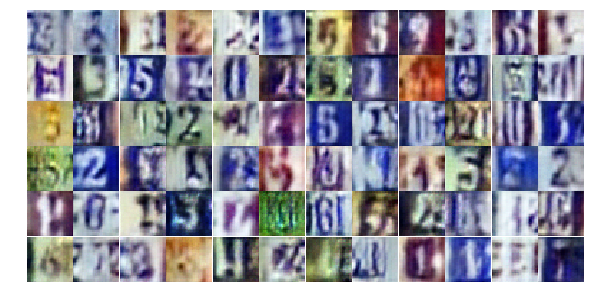

Epoch 7/20... Discriminator Loss: 0.5568... Generator Loss: 1.9404
Epoch 7/20... Discriminator Loss: 0.6769... Generator Loss: 1.1829
Epoch 7/20... Discriminator Loss: 0.8375... Generator Loss: 0.8494
Epoch 7/20... Discriminator Loss: 0.7842... Generator Loss: 0.9137
Epoch 7/20... Discriminator Loss: 0.6412... Generator Loss: 1.1494
Epoch 7/20... Discriminator Loss: 0.6069... Generator Loss: 1.3763
Epoch 7/20... Discriminator Loss: 0.8002... Generator Loss: 0.8106
Epoch 7/20... Discriminator Loss: 0.8946... Generator Loss: 1.4811
Epoch 7/20... Discriminator Loss: 0.6495... Generator Loss: 1.1579
Epoch 7/20... Discriminator Loss: 1.6260... Generator Loss: 0.3291


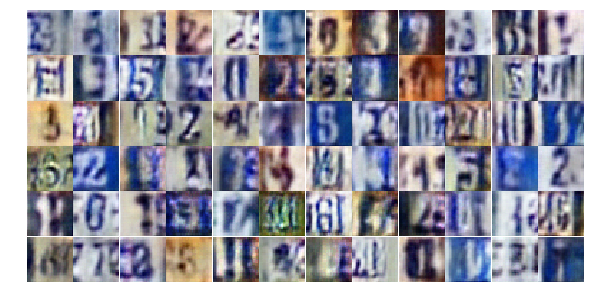

Epoch 7/20... Discriminator Loss: 0.6414... Generator Loss: 1.7342
Epoch 8/20... Discriminator Loss: 0.9388... Generator Loss: 0.6975
Epoch 8/20... Discriminator Loss: 0.8151... Generator Loss: 0.7981
Epoch 8/20... Discriminator Loss: 0.8470... Generator Loss: 0.8176
Epoch 8/20... Discriminator Loss: 0.6349... Generator Loss: 1.1483
Epoch 8/20... Discriminator Loss: 0.9535... Generator Loss: 0.8996
Epoch 8/20... Discriminator Loss: 0.8016... Generator Loss: 1.0800
Epoch 8/20... Discriminator Loss: 0.5986... Generator Loss: 1.3006
Epoch 8/20... Discriminator Loss: 1.2244... Generator Loss: 0.5675
Epoch 8/20... Discriminator Loss: 0.8085... Generator Loss: 0.8930


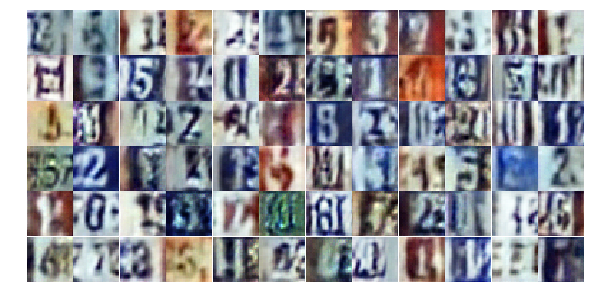

Epoch 8/20... Discriminator Loss: 0.6218... Generator Loss: 1.4325
Epoch 8/20... Discriminator Loss: 0.6218... Generator Loss: 1.7326
Epoch 8/20... Discriminator Loss: 0.7924... Generator Loss: 1.1760
Epoch 8/20... Discriminator Loss: 0.6495... Generator Loss: 2.2569
Epoch 8/20... Discriminator Loss: 1.3244... Generator Loss: 0.4207
Epoch 8/20... Discriminator Loss: 0.9174... Generator Loss: 2.3915
Epoch 8/20... Discriminator Loss: 0.4850... Generator Loss: 1.8266
Epoch 8/20... Discriminator Loss: 0.5675... Generator Loss: 1.4104
Epoch 8/20... Discriminator Loss: 0.7932... Generator Loss: 0.8960
Epoch 8/20... Discriminator Loss: 1.2494... Generator Loss: 0.4764


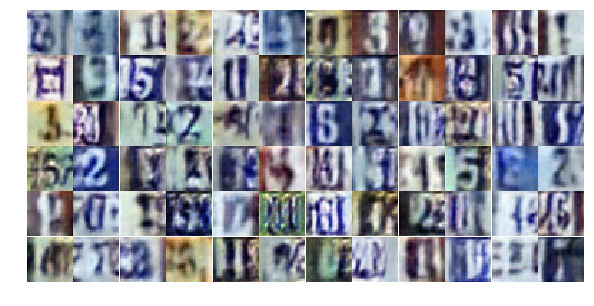

Epoch 8/20... Discriminator Loss: 0.6257... Generator Loss: 1.2278
Epoch 8/20... Discriminator Loss: 0.3845... Generator Loss: 1.8644
Epoch 8/20... Discriminator Loss: 0.7270... Generator Loss: 1.6454
Epoch 8/20... Discriminator Loss: 0.9436... Generator Loss: 2.3789
Epoch 8/20... Discriminator Loss: 0.5402... Generator Loss: 1.3937
Epoch 8/20... Discriminator Loss: 0.6613... Generator Loss: 1.2040
Epoch 8/20... Discriminator Loss: 0.5307... Generator Loss: 1.8150
Epoch 8/20... Discriminator Loss: 0.5870... Generator Loss: 1.5380
Epoch 8/20... Discriminator Loss: 0.7751... Generator Loss: 1.0186
Epoch 8/20... Discriminator Loss: 0.5175... Generator Loss: 1.9874


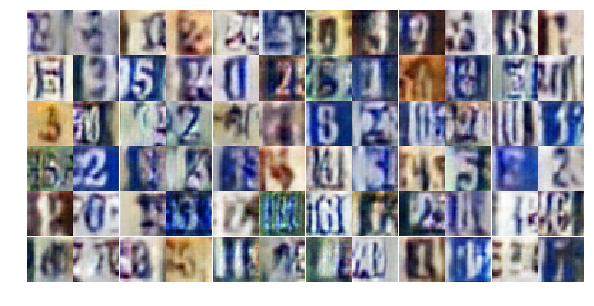

Epoch 8/20... Discriminator Loss: 0.6216... Generator Loss: 1.2960
Epoch 8/20... Discriminator Loss: 1.1956... Generator Loss: 0.5406
Epoch 8/20... Discriminator Loss: 1.1244... Generator Loss: 0.5717
Epoch 8/20... Discriminator Loss: 0.8683... Generator Loss: 0.7292
Epoch 8/20... Discriminator Loss: 0.9524... Generator Loss: 0.6915
Epoch 8/20... Discriminator Loss: 0.5602... Generator Loss: 1.2167
Epoch 8/20... Discriminator Loss: 0.5075... Generator Loss: 1.6504
Epoch 8/20... Discriminator Loss: 0.6228... Generator Loss: 1.2337
Epoch 8/20... Discriminator Loss: 0.8469... Generator Loss: 1.4406
Epoch 8/20... Discriminator Loss: 0.5317... Generator Loss: 1.3744


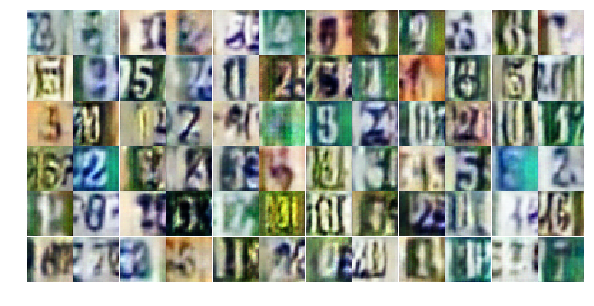

Epoch 8/20... Discriminator Loss: 1.6231... Generator Loss: 3.4666
Epoch 8/20... Discriminator Loss: 1.1994... Generator Loss: 0.5482
Epoch 8/20... Discriminator Loss: 1.2078... Generator Loss: 0.5050
Epoch 8/20... Discriminator Loss: 0.7100... Generator Loss: 0.9600
Epoch 8/20... Discriminator Loss: 0.9048... Generator Loss: 1.7561
Epoch 8/20... Discriminator Loss: 0.9641... Generator Loss: 0.6392
Epoch 8/20... Discriminator Loss: 0.5300... Generator Loss: 1.8222
Epoch 8/20... Discriminator Loss: 0.4460... Generator Loss: 1.6320
Epoch 8/20... Discriminator Loss: 0.8017... Generator Loss: 1.4480
Epoch 8/20... Discriminator Loss: 0.6839... Generator Loss: 1.0968


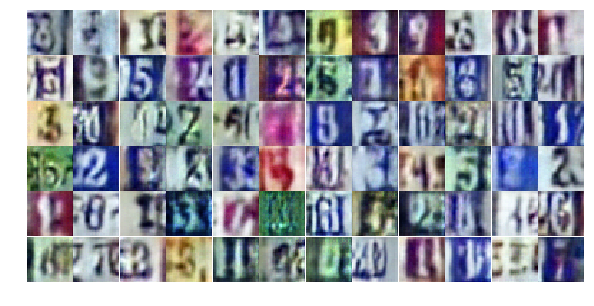

Epoch 8/20... Discriminator Loss: 0.5525... Generator Loss: 1.1758
Epoch 8/20... Discriminator Loss: 0.4743... Generator Loss: 1.6233
Epoch 8/20... Discriminator Loss: 0.6105... Generator Loss: 1.5582
Epoch 8/20... Discriminator Loss: 0.8055... Generator Loss: 1.1154
Epoch 8/20... Discriminator Loss: 0.6135... Generator Loss: 3.0142
Epoch 8/20... Discriminator Loss: 0.6593... Generator Loss: 1.3549
Epoch 8/20... Discriminator Loss: 0.6566... Generator Loss: 1.1375
Epoch 8/20... Discriminator Loss: 0.7399... Generator Loss: 1.3000
Epoch 9/20... Discriminator Loss: 1.8662... Generator Loss: 0.2751
Epoch 9/20... Discriminator Loss: 0.8696... Generator Loss: 0.7332


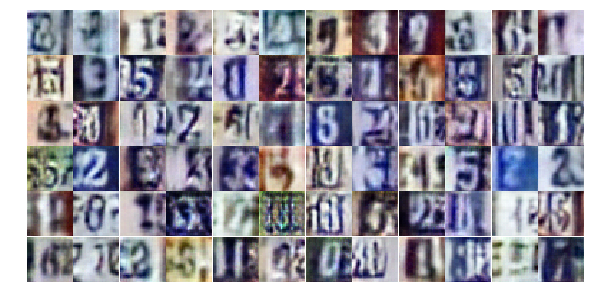

Epoch 9/20... Discriminator Loss: 0.7504... Generator Loss: 1.1402
Epoch 9/20... Discriminator Loss: 0.6867... Generator Loss: 1.4972
Epoch 9/20... Discriminator Loss: 0.6872... Generator Loss: 1.0827
Epoch 9/20... Discriminator Loss: 0.5400... Generator Loss: 1.5357
Epoch 9/20... Discriminator Loss: 1.0240... Generator Loss: 0.6380
Epoch 9/20... Discriminator Loss: 0.7984... Generator Loss: 2.7018
Epoch 9/20... Discriminator Loss: 0.7776... Generator Loss: 0.9596
Epoch 9/20... Discriminator Loss: 0.6487... Generator Loss: 1.2947
Epoch 9/20... Discriminator Loss: 0.8265... Generator Loss: 0.8572
Epoch 9/20... Discriminator Loss: 0.7480... Generator Loss: 1.1608


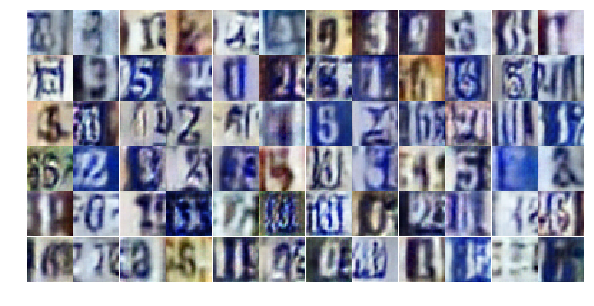

Epoch 9/20... Discriminator Loss: 0.8970... Generator Loss: 0.7586
Epoch 9/20... Discriminator Loss: 1.8264... Generator Loss: 0.2560
Epoch 9/20... Discriminator Loss: 0.8374... Generator Loss: 1.1780
Epoch 9/20... Discriminator Loss: 0.7572... Generator Loss: 0.9183
Epoch 9/20... Discriminator Loss: 0.5680... Generator Loss: 1.2242
Epoch 9/20... Discriminator Loss: 0.7107... Generator Loss: 1.7745
Epoch 9/20... Discriminator Loss: 0.9674... Generator Loss: 0.6917
Epoch 9/20... Discriminator Loss: 0.5755... Generator Loss: 1.4931
Epoch 9/20... Discriminator Loss: 1.3308... Generator Loss: 0.4129
Epoch 9/20... Discriminator Loss: 0.9918... Generator Loss: 0.6757


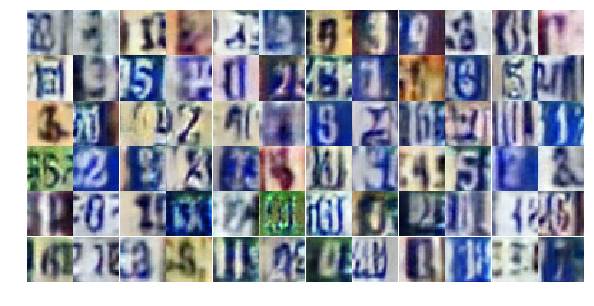

Epoch 9/20... Discriminator Loss: 1.2709... Generator Loss: 0.4536
Epoch 9/20... Discriminator Loss: 0.6617... Generator Loss: 1.2385
Epoch 9/20... Discriminator Loss: 0.7167... Generator Loss: 1.3699
Epoch 9/20... Discriminator Loss: 0.5799... Generator Loss: 1.3080
Epoch 9/20... Discriminator Loss: 0.6178... Generator Loss: 1.6689
Epoch 9/20... Discriminator Loss: 0.5742... Generator Loss: 1.4209
Epoch 9/20... Discriminator Loss: 1.6338... Generator Loss: 0.3390
Epoch 9/20... Discriminator Loss: 0.6796... Generator Loss: 1.2174
Epoch 9/20... Discriminator Loss: 0.6546... Generator Loss: 1.0617
Epoch 9/20... Discriminator Loss: 0.5818... Generator Loss: 1.1949


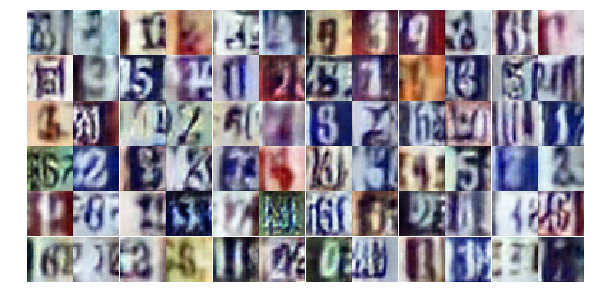

Epoch 9/20... Discriminator Loss: 0.7614... Generator Loss: 0.8974
Epoch 9/20... Discriminator Loss: 0.8216... Generator Loss: 0.7659
Epoch 9/20... Discriminator Loss: 0.7231... Generator Loss: 0.9047
Epoch 9/20... Discriminator Loss: 1.1500... Generator Loss: 0.6104
Epoch 9/20... Discriminator Loss: 0.7128... Generator Loss: 0.9975
Epoch 9/20... Discriminator Loss: 0.6946... Generator Loss: 1.1179
Epoch 9/20... Discriminator Loss: 0.6088... Generator Loss: 1.3209
Epoch 9/20... Discriminator Loss: 0.3825... Generator Loss: 1.5663
Epoch 9/20... Discriminator Loss: 1.2486... Generator Loss: 0.4745
Epoch 9/20... Discriminator Loss: 0.9257... Generator Loss: 0.7247


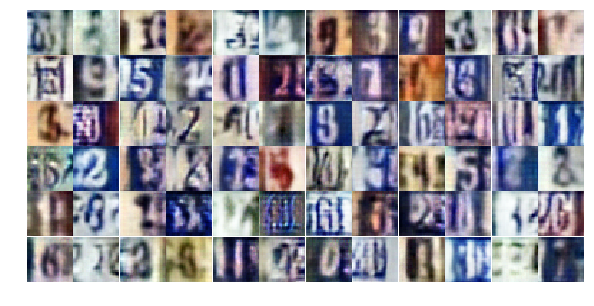

Epoch 9/20... Discriminator Loss: 0.7084... Generator Loss: 1.0116
Epoch 9/20... Discriminator Loss: 0.8691... Generator Loss: 0.8254
Epoch 9/20... Discriminator Loss: 0.7750... Generator Loss: 1.9595
Epoch 9/20... Discriminator Loss: 0.7266... Generator Loss: 1.1416
Epoch 9/20... Discriminator Loss: 0.5395... Generator Loss: 1.6940
Epoch 9/20... Discriminator Loss: 0.8781... Generator Loss: 0.7862
Epoch 9/20... Discriminator Loss: 1.8145... Generator Loss: 0.2681
Epoch 9/20... Discriminator Loss: 1.2268... Generator Loss: 0.4911
Epoch 9/20... Discriminator Loss: 0.6660... Generator Loss: 1.6950
Epoch 9/20... Discriminator Loss: 0.6619... Generator Loss: 1.5854


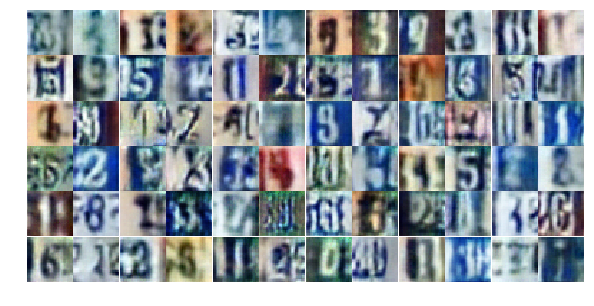

Epoch 9/20... Discriminator Loss: 0.7318... Generator Loss: 1.0313
Epoch 9/20... Discriminator Loss: 1.2313... Generator Loss: 2.4123
Epoch 9/20... Discriminator Loss: 0.5900... Generator Loss: 1.2388
Epoch 9/20... Discriminator Loss: 1.6120... Generator Loss: 0.3200
Epoch 9/20... Discriminator Loss: 0.8153... Generator Loss: 1.0881
Epoch 10/20... Discriminator Loss: 0.5610... Generator Loss: 1.4787
Epoch 10/20... Discriminator Loss: 0.6484... Generator Loss: 1.1212
Epoch 10/20... Discriminator Loss: 0.4797... Generator Loss: 1.3291
Epoch 10/20... Discriminator Loss: 0.7720... Generator Loss: 0.9796
Epoch 10/20... Discriminator Loss: 1.4171... Generator Loss: 0.3903


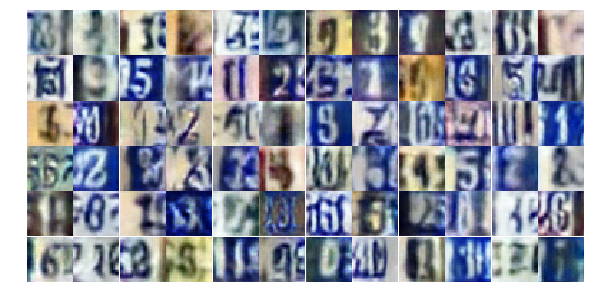

Epoch 10/20... Discriminator Loss: 0.9499... Generator Loss: 0.6750
Epoch 10/20... Discriminator Loss: 0.7005... Generator Loss: 0.9986
Epoch 10/20... Discriminator Loss: 0.6073... Generator Loss: 1.1710
Epoch 10/20... Discriminator Loss: 0.7389... Generator Loss: 1.3619
Epoch 10/20... Discriminator Loss: 0.9031... Generator Loss: 1.2859
Epoch 10/20... Discriminator Loss: 1.0149... Generator Loss: 0.6636
Epoch 10/20... Discriminator Loss: 0.6220... Generator Loss: 1.1011
Epoch 10/20... Discriminator Loss: 0.9754... Generator Loss: 0.6237
Epoch 10/20... Discriminator Loss: 1.6767... Generator Loss: 0.3676
Epoch 10/20... Discriminator Loss: 0.8139... Generator Loss: 0.9451


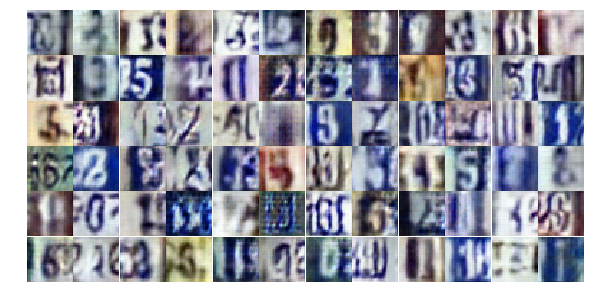

Epoch 10/20... Discriminator Loss: 0.6466... Generator Loss: 1.5434
Epoch 10/20... Discriminator Loss: 0.8747... Generator Loss: 0.9417
Epoch 10/20... Discriminator Loss: 0.7111... Generator Loss: 1.1281
Epoch 10/20... Discriminator Loss: 1.4441... Generator Loss: 0.3644
Epoch 10/20... Discriminator Loss: 1.0183... Generator Loss: 2.0201
Epoch 10/20... Discriminator Loss: 0.9370... Generator Loss: 0.7191
Epoch 10/20... Discriminator Loss: 1.0347... Generator Loss: 0.5799
Epoch 10/20... Discriminator Loss: 0.5528... Generator Loss: 1.3401
Epoch 10/20... Discriminator Loss: 0.7006... Generator Loss: 1.1400
Epoch 10/20... Discriminator Loss: 0.7506... Generator Loss: 2.9651


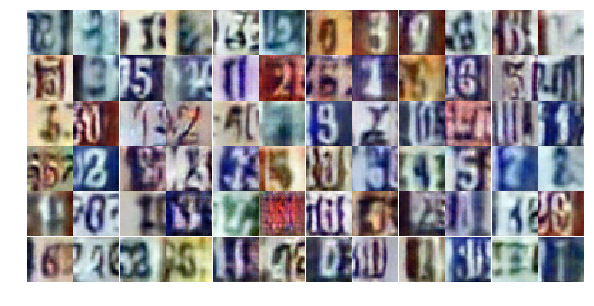

Epoch 10/20... Discriminator Loss: 0.7791... Generator Loss: 0.9313
Epoch 10/20... Discriminator Loss: 0.7463... Generator Loss: 1.0855
Epoch 10/20... Discriminator Loss: 0.5293... Generator Loss: 1.1789
Epoch 10/20... Discriminator Loss: 0.5575... Generator Loss: 2.2055
Epoch 10/20... Discriminator Loss: 1.2863... Generator Loss: 0.4294
Epoch 10/20... Discriminator Loss: 0.6463... Generator Loss: 1.1383
Epoch 10/20... Discriminator Loss: 0.4136... Generator Loss: 1.6737
Epoch 10/20... Discriminator Loss: 0.9930... Generator Loss: 0.7153
Epoch 10/20... Discriminator Loss: 0.8765... Generator Loss: 0.7386
Epoch 10/20... Discriminator Loss: 0.6450... Generator Loss: 1.3032


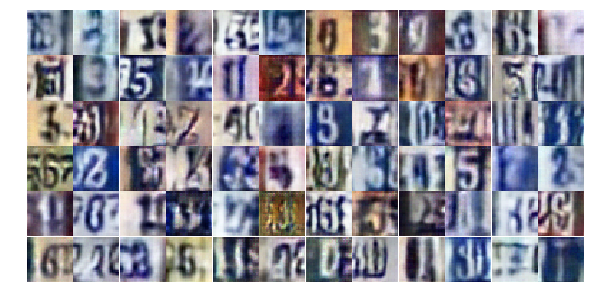

Epoch 10/20... Discriminator Loss: 0.6117... Generator Loss: 1.1791
Epoch 10/20... Discriminator Loss: 0.6340... Generator Loss: 1.2283
Epoch 10/20... Discriminator Loss: 0.5220... Generator Loss: 1.6919
Epoch 10/20... Discriminator Loss: 0.7417... Generator Loss: 0.9781
Epoch 10/20... Discriminator Loss: 0.6375... Generator Loss: 1.4207
Epoch 10/20... Discriminator Loss: 1.0327... Generator Loss: 0.6272
Epoch 10/20... Discriminator Loss: 0.8155... Generator Loss: 0.9089
Epoch 10/20... Discriminator Loss: 0.5201... Generator Loss: 1.2987
Epoch 10/20... Discriminator Loss: 0.8507... Generator Loss: 0.8154
Epoch 10/20... Discriminator Loss: 0.6202... Generator Loss: 1.9516


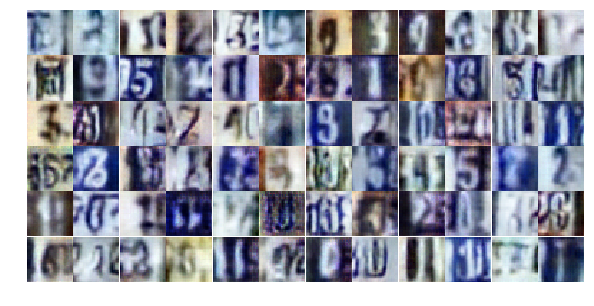

Epoch 10/20... Discriminator Loss: 0.9633... Generator Loss: 0.7176
Epoch 10/20... Discriminator Loss: 0.7827... Generator Loss: 0.9657
Epoch 10/20... Discriminator Loss: 0.6313... Generator Loss: 0.9883
Epoch 10/20... Discriminator Loss: 0.6378... Generator Loss: 1.1885
Epoch 10/20... Discriminator Loss: 0.7310... Generator Loss: 1.2745
Epoch 10/20... Discriminator Loss: 0.9287... Generator Loss: 0.6649
Epoch 10/20... Discriminator Loss: 0.9900... Generator Loss: 0.7111
Epoch 10/20... Discriminator Loss: 0.9633... Generator Loss: 2.6426
Epoch 10/20... Discriminator Loss: 0.6496... Generator Loss: 1.8931
Epoch 10/20... Discriminator Loss: 0.6941... Generator Loss: 1.0720


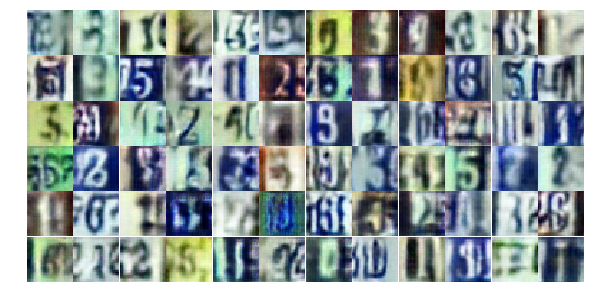

Epoch 10/20... Discriminator Loss: 0.7005... Generator Loss: 1.2936
Epoch 10/20... Discriminator Loss: 0.6583... Generator Loss: 1.1871
Epoch 10/20... Discriminator Loss: 0.4301... Generator Loss: 1.4534
Epoch 11/20... Discriminator Loss: 1.2812... Generator Loss: 0.5532
Epoch 11/20... Discriminator Loss: 0.6328... Generator Loss: 1.2387
Epoch 11/20... Discriminator Loss: 1.2200... Generator Loss: 0.5043
Epoch 11/20... Discriminator Loss: 0.5747... Generator Loss: 1.2520
Epoch 11/20... Discriminator Loss: 0.6610... Generator Loss: 1.5021
Epoch 11/20... Discriminator Loss: 2.0845... Generator Loss: 0.1795
Epoch 11/20... Discriminator Loss: 0.4488... Generator Loss: 1.7472


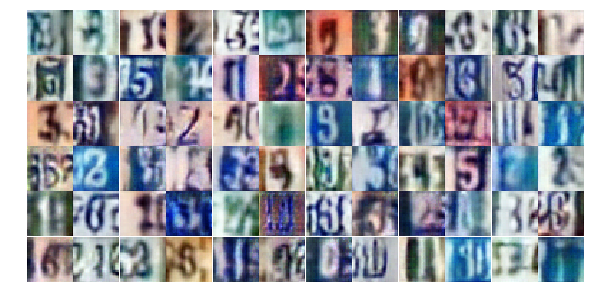

Epoch 11/20... Discriminator Loss: 0.5040... Generator Loss: 2.0116
Epoch 11/20... Discriminator Loss: 1.2251... Generator Loss: 2.8421
Epoch 11/20... Discriminator Loss: 0.4711... Generator Loss: 1.3584
Epoch 11/20... Discriminator Loss: 0.7798... Generator Loss: 0.8661
Epoch 11/20... Discriminator Loss: 0.7845... Generator Loss: 1.4989
Epoch 11/20... Discriminator Loss: 0.4635... Generator Loss: 1.7190
Epoch 11/20... Discriminator Loss: 0.5696... Generator Loss: 1.5062
Epoch 11/20... Discriminator Loss: 0.4907... Generator Loss: 1.9763
Epoch 11/20... Discriminator Loss: 0.6852... Generator Loss: 1.1261
Epoch 11/20... Discriminator Loss: 1.2502... Generator Loss: 0.4331


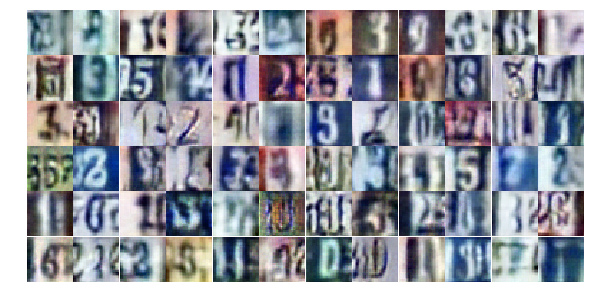

Epoch 11/20... Discriminator Loss: 0.9788... Generator Loss: 0.7263
Epoch 11/20... Discriminator Loss: 0.4835... Generator Loss: 1.5302
Epoch 11/20... Discriminator Loss: 0.9742... Generator Loss: 0.6618
Epoch 11/20... Discriminator Loss: 0.7232... Generator Loss: 0.9609
Epoch 11/20... Discriminator Loss: 0.5123... Generator Loss: 1.7220
Epoch 11/20... Discriminator Loss: 0.4194... Generator Loss: 1.7146
Epoch 11/20... Discriminator Loss: 0.5350... Generator Loss: 1.3727
Epoch 11/20... Discriminator Loss: 1.1001... Generator Loss: 0.6295
Epoch 11/20... Discriminator Loss: 0.4673... Generator Loss: 1.7069
Epoch 11/20... Discriminator Loss: 0.8066... Generator Loss: 0.8599


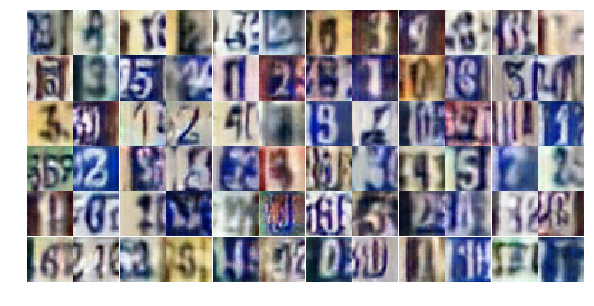

Epoch 11/20... Discriminator Loss: 0.8195... Generator Loss: 0.8537
Epoch 11/20... Discriminator Loss: 0.6687... Generator Loss: 1.1596
Epoch 11/20... Discriminator Loss: 1.1916... Generator Loss: 0.4939
Epoch 11/20... Discriminator Loss: 0.5225... Generator Loss: 1.3327
Epoch 11/20... Discriminator Loss: 0.5861... Generator Loss: 1.1479
Epoch 11/20... Discriminator Loss: 1.0964... Generator Loss: 0.6036
Epoch 11/20... Discriminator Loss: 1.0709... Generator Loss: 0.6382
Epoch 11/20... Discriminator Loss: 1.0805... Generator Loss: 0.5681
Epoch 11/20... Discriminator Loss: 0.5774... Generator Loss: 1.4329
Epoch 11/20... Discriminator Loss: 0.8784... Generator Loss: 0.8881


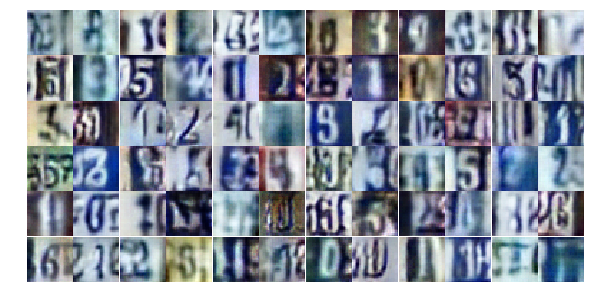

Epoch 11/20... Discriminator Loss: 0.5414... Generator Loss: 1.3651
Epoch 11/20... Discriminator Loss: 0.5562... Generator Loss: 1.2094
Epoch 11/20... Discriminator Loss: 0.5600... Generator Loss: 1.5127
Epoch 11/20... Discriminator Loss: 0.5907... Generator Loss: 1.3482
Epoch 11/20... Discriminator Loss: 0.9901... Generator Loss: 0.6260
Epoch 11/20... Discriminator Loss: 1.3425... Generator Loss: 0.4227
Epoch 11/20... Discriminator Loss: 0.5463... Generator Loss: 1.2654
Epoch 11/20... Discriminator Loss: 2.2410... Generator Loss: 0.1542
Epoch 11/20... Discriminator Loss: 1.1760... Generator Loss: 0.6337
Epoch 11/20... Discriminator Loss: 0.5053... Generator Loss: 1.3947


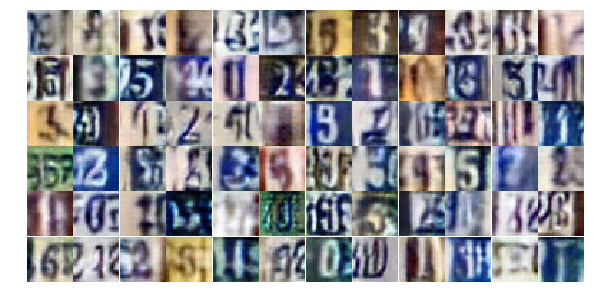

Epoch 11/20... Discriminator Loss: 1.1966... Generator Loss: 0.5534
Epoch 11/20... Discriminator Loss: 0.4116... Generator Loss: 1.8282
Epoch 11/20... Discriminator Loss: 0.6900... Generator Loss: 1.1590
Epoch 11/20... Discriminator Loss: 0.7982... Generator Loss: 0.7944
Epoch 11/20... Discriminator Loss: 1.1548... Generator Loss: 0.5556
Epoch 11/20... Discriminator Loss: 0.6892... Generator Loss: 1.0541
Epoch 11/20... Discriminator Loss: 0.9117... Generator Loss: 0.7188
Epoch 11/20... Discriminator Loss: 0.5390... Generator Loss: 1.5153
Epoch 11/20... Discriminator Loss: 0.7000... Generator Loss: 1.2702
Epoch 11/20... Discriminator Loss: 0.9788... Generator Loss: 0.6381


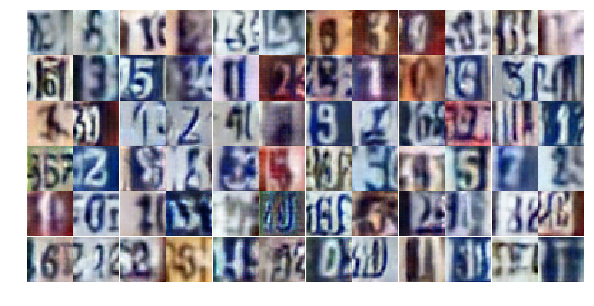

Epoch 12/20... Discriminator Loss: 0.7983... Generator Loss: 0.9896
Epoch 12/20... Discriminator Loss: 0.8673... Generator Loss: 0.7865
Epoch 12/20... Discriminator Loss: 0.8859... Generator Loss: 0.8602
Epoch 12/20... Discriminator Loss: 0.7890... Generator Loss: 1.1934
Epoch 12/20... Discriminator Loss: 0.6912... Generator Loss: 1.7756
Epoch 12/20... Discriminator Loss: 0.7945... Generator Loss: 0.8292
Epoch 12/20... Discriminator Loss: 0.7893... Generator Loss: 1.1479
Epoch 12/20... Discriminator Loss: 0.7385... Generator Loss: 1.1596
Epoch 12/20... Discriminator Loss: 0.7553... Generator Loss: 1.4214
Epoch 12/20... Discriminator Loss: 1.5901... Generator Loss: 0.3354


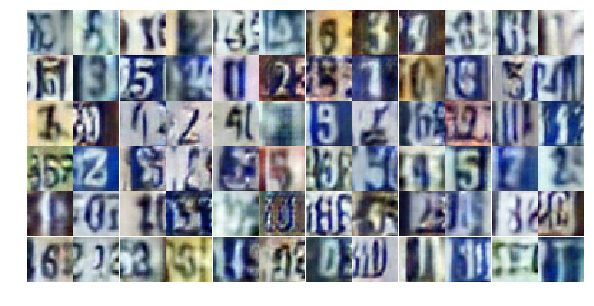

Epoch 12/20... Discriminator Loss: 0.5993... Generator Loss: 1.1971
Epoch 12/20... Discriminator Loss: 0.9001... Generator Loss: 0.7284
Epoch 12/20... Discriminator Loss: 0.6388... Generator Loss: 1.0827
Epoch 12/20... Discriminator Loss: 0.6747... Generator Loss: 2.1152
Epoch 12/20... Discriminator Loss: 0.4316... Generator Loss: 2.1851
Epoch 12/20... Discriminator Loss: 1.5104... Generator Loss: 2.0957
Epoch 12/20... Discriminator Loss: 1.4218... Generator Loss: 0.4505
Epoch 12/20... Discriminator Loss: 0.6119... Generator Loss: 1.1348
Epoch 12/20... Discriminator Loss: 0.7555... Generator Loss: 0.8727
Epoch 12/20... Discriminator Loss: 1.0671... Generator Loss: 0.6215


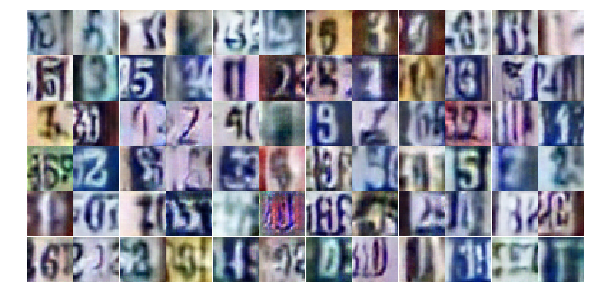

Epoch 12/20... Discriminator Loss: 0.5449... Generator Loss: 1.3559
Epoch 12/20... Discriminator Loss: 0.6075... Generator Loss: 1.7654
Epoch 12/20... Discriminator Loss: 0.8390... Generator Loss: 0.8641
Epoch 12/20... Discriminator Loss: 0.6471... Generator Loss: 1.0468
Epoch 12/20... Discriminator Loss: 0.5960... Generator Loss: 1.6617
Epoch 12/20... Discriminator Loss: 0.5373... Generator Loss: 1.5291
Epoch 12/20... Discriminator Loss: 0.8330... Generator Loss: 0.7888
Epoch 12/20... Discriminator Loss: 0.3803... Generator Loss: 2.0156
Epoch 12/20... Discriminator Loss: 0.6338... Generator Loss: 1.1167
Epoch 12/20... Discriminator Loss: 0.8422... Generator Loss: 0.9367


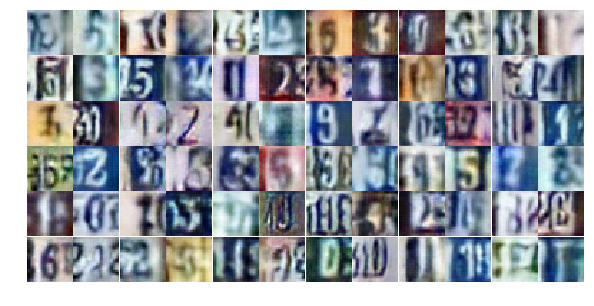

Epoch 12/20... Discriminator Loss: 0.7445... Generator Loss: 0.8809
Epoch 12/20... Discriminator Loss: 1.0124... Generator Loss: 0.6773
Epoch 12/20... Discriminator Loss: 1.1942... Generator Loss: 0.4807
Epoch 12/20... Discriminator Loss: 1.7778... Generator Loss: 0.2841
Epoch 12/20... Discriminator Loss: 0.7628... Generator Loss: 0.9166
Epoch 12/20... Discriminator Loss: 1.3093... Generator Loss: 0.4323
Epoch 12/20... Discriminator Loss: 0.7499... Generator Loss: 1.0371
Epoch 12/20... Discriminator Loss: 0.6732... Generator Loss: 1.1431
Epoch 12/20... Discriminator Loss: 0.6553... Generator Loss: 1.2053
Epoch 12/20... Discriminator Loss: 0.3995... Generator Loss: 1.8243


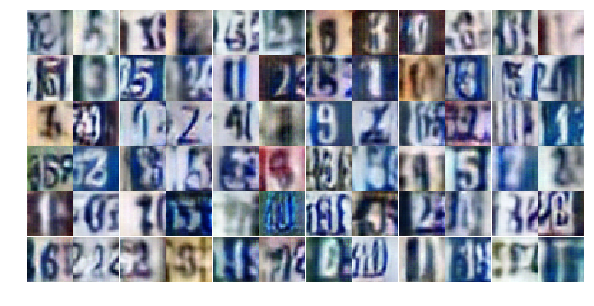

Epoch 12/20... Discriminator Loss: 0.5571... Generator Loss: 1.3259
Epoch 12/20... Discriminator Loss: 0.6042... Generator Loss: 1.6190
Epoch 12/20... Discriminator Loss: 0.7101... Generator Loss: 0.9718
Epoch 12/20... Discriminator Loss: 0.7327... Generator Loss: 1.4640
Epoch 12/20... Discriminator Loss: 0.8009... Generator Loss: 0.9510
Epoch 12/20... Discriminator Loss: 1.0687... Generator Loss: 0.6260
Epoch 12/20... Discriminator Loss: 0.9630... Generator Loss: 0.6542
Epoch 12/20... Discriminator Loss: 1.0153... Generator Loss: 0.7131
Epoch 12/20... Discriminator Loss: 0.5174... Generator Loss: 1.4243
Epoch 12/20... Discriminator Loss: 0.9623... Generator Loss: 0.7736


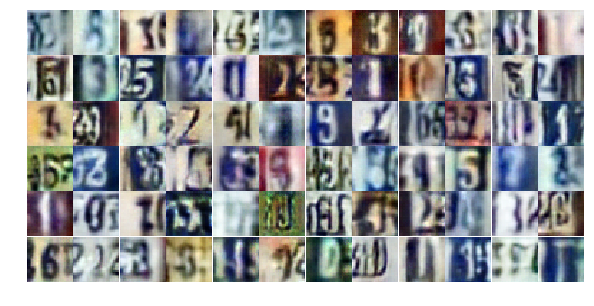

Epoch 12/20... Discriminator Loss: 1.1164... Generator Loss: 0.5648
Epoch 12/20... Discriminator Loss: 0.5383... Generator Loss: 1.2873
Epoch 12/20... Discriminator Loss: 1.0405... Generator Loss: 0.6239
Epoch 12/20... Discriminator Loss: 0.9065... Generator Loss: 1.1449
Epoch 12/20... Discriminator Loss: 0.6145... Generator Loss: 1.2227
Epoch 12/20... Discriminator Loss: 0.7648... Generator Loss: 1.3060
Epoch 12/20... Discriminator Loss: 0.8004... Generator Loss: 1.0060
Epoch 13/20... Discriminator Loss: 0.7893... Generator Loss: 0.8536
Epoch 13/20... Discriminator Loss: 0.5192... Generator Loss: 1.5734
Epoch 13/20... Discriminator Loss: 0.8958... Generator Loss: 0.7349


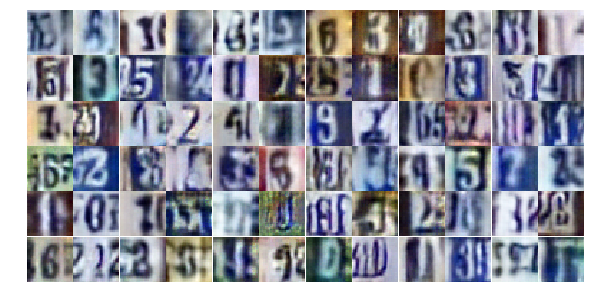

Epoch 13/20... Discriminator Loss: 0.5867... Generator Loss: 1.3420
Epoch 13/20... Discriminator Loss: 0.6507... Generator Loss: 3.0504
Epoch 13/20... Discriminator Loss: 1.2414... Generator Loss: 0.6075
Epoch 13/20... Discriminator Loss: 1.4085... Generator Loss: 0.4773
Epoch 13/20... Discriminator Loss: 0.7105... Generator Loss: 1.0009
Epoch 13/20... Discriminator Loss: 0.6098... Generator Loss: 1.1020
Epoch 13/20... Discriminator Loss: 0.4025... Generator Loss: 1.7401
Epoch 13/20... Discriminator Loss: 0.8556... Generator Loss: 0.7396
Epoch 13/20... Discriminator Loss: 0.5451... Generator Loss: 1.1230
Epoch 13/20... Discriminator Loss: 0.5982... Generator Loss: 1.3185


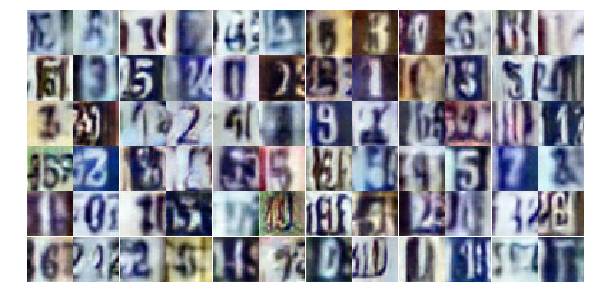

Epoch 13/20... Discriminator Loss: 0.8449... Generator Loss: 0.7434
Epoch 13/20... Discriminator Loss: 0.5883... Generator Loss: 2.4088
Epoch 13/20... Discriminator Loss: 1.3018... Generator Loss: 0.4572
Epoch 13/20... Discriminator Loss: 0.6490... Generator Loss: 1.1685
Epoch 13/20... Discriminator Loss: 0.8311... Generator Loss: 0.9529
Epoch 13/20... Discriminator Loss: 0.9633... Generator Loss: 0.7426
Epoch 13/20... Discriminator Loss: 0.7454... Generator Loss: 0.9919
Epoch 13/20... Discriminator Loss: 1.2330... Generator Loss: 0.4945
Epoch 13/20... Discriminator Loss: 0.6797... Generator Loss: 1.2013
Epoch 13/20... Discriminator Loss: 1.1372... Generator Loss: 0.5211


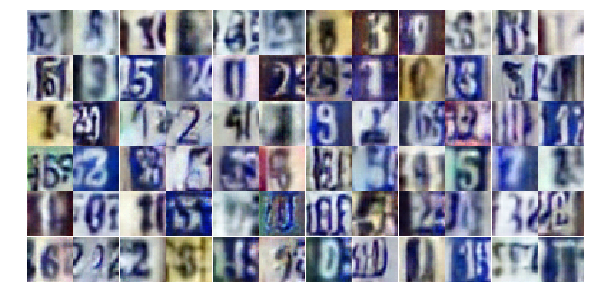

Epoch 13/20... Discriminator Loss: 0.8059... Generator Loss: 0.8649
Epoch 13/20... Discriminator Loss: 0.6074... Generator Loss: 1.4488
Epoch 13/20... Discriminator Loss: 0.7349... Generator Loss: 1.6863
Epoch 13/20... Discriminator Loss: 0.5728... Generator Loss: 1.1984
Epoch 13/20... Discriminator Loss: 0.8348... Generator Loss: 0.8884
Epoch 13/20... Discriminator Loss: 1.0267... Generator Loss: 0.5822
Epoch 13/20... Discriminator Loss: 0.5769... Generator Loss: 1.8651
Epoch 13/20... Discriminator Loss: 0.5487... Generator Loss: 1.3342
Epoch 13/20... Discriminator Loss: 0.5945... Generator Loss: 1.2658
Epoch 13/20... Discriminator Loss: 0.6312... Generator Loss: 1.1469


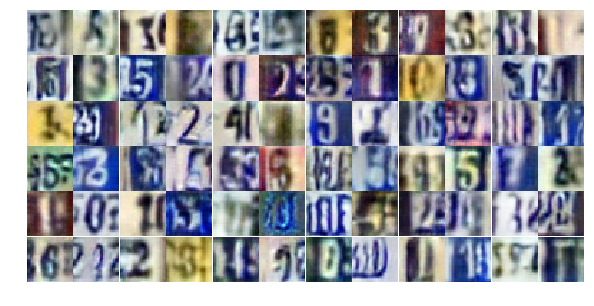

Epoch 13/20... Discriminator Loss: 0.6616... Generator Loss: 1.1623
Epoch 13/20... Discriminator Loss: 0.6193... Generator Loss: 1.6209
Epoch 13/20... Discriminator Loss: 2.8520... Generator Loss: 0.0997
Epoch 13/20... Discriminator Loss: 1.0033... Generator Loss: 1.1984
Epoch 13/20... Discriminator Loss: 0.9011... Generator Loss: 0.8449
Epoch 13/20... Discriminator Loss: 0.5085... Generator Loss: 1.5104
Epoch 13/20... Discriminator Loss: 0.6714... Generator Loss: 1.0633
Epoch 13/20... Discriminator Loss: 1.0468... Generator Loss: 0.6758
Epoch 13/20... Discriminator Loss: 0.6072... Generator Loss: 1.3039
Epoch 13/20... Discriminator Loss: 0.8244... Generator Loss: 0.8481


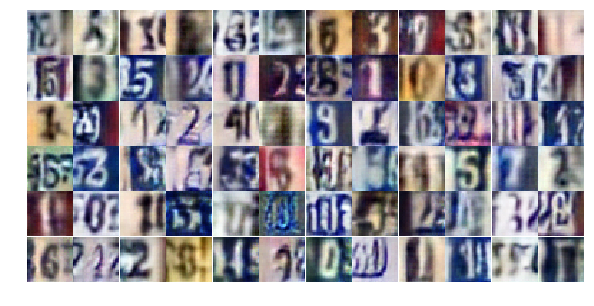

Epoch 13/20... Discriminator Loss: 0.7199... Generator Loss: 1.0814
Epoch 13/20... Discriminator Loss: 0.8276... Generator Loss: 0.8634
Epoch 13/20... Discriminator Loss: 0.8268... Generator Loss: 0.9522
Epoch 13/20... Discriminator Loss: 0.7528... Generator Loss: 1.0040
Epoch 13/20... Discriminator Loss: 1.2311... Generator Loss: 0.4741
Epoch 13/20... Discriminator Loss: 0.6371... Generator Loss: 1.5085
Epoch 13/20... Discriminator Loss: 0.7861... Generator Loss: 0.8776
Epoch 13/20... Discriminator Loss: 0.6372... Generator Loss: 1.0440
Epoch 13/20... Discriminator Loss: 1.0618... Generator Loss: 0.6333
Epoch 13/20... Discriminator Loss: 1.0161... Generator Loss: 0.6376


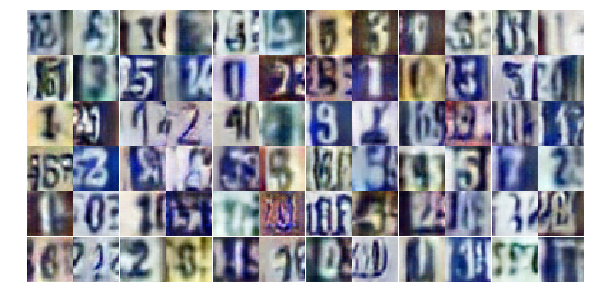

Epoch 13/20... Discriminator Loss: 0.4331... Generator Loss: 1.7345
Epoch 13/20... Discriminator Loss: 1.2043... Generator Loss: 0.4796
Epoch 13/20... Discriminator Loss: 0.9274... Generator Loss: 0.7262
Epoch 13/20... Discriminator Loss: 0.9257... Generator Loss: 0.7569
Epoch 14/20... Discriminator Loss: 1.0398... Generator Loss: 0.6296
Epoch 14/20... Discriminator Loss: 0.6277... Generator Loss: 1.4337
Epoch 14/20... Discriminator Loss: 1.0383... Generator Loss: 0.6634
Epoch 14/20... Discriminator Loss: 0.6344... Generator Loss: 1.6108
Epoch 14/20... Discriminator Loss: 0.6508... Generator Loss: 1.4566
Epoch 14/20... Discriminator Loss: 0.7224... Generator Loss: 1.7228


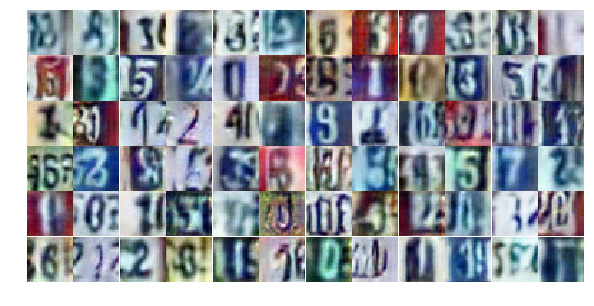

Epoch 14/20... Discriminator Loss: 0.5434... Generator Loss: 1.6325
Epoch 14/20... Discriminator Loss: 0.7663... Generator Loss: 0.8544
Epoch 14/20... Discriminator Loss: 0.8407... Generator Loss: 1.2659
Epoch 14/20... Discriminator Loss: 1.1460... Generator Loss: 2.1515
Epoch 14/20... Discriminator Loss: 1.0566... Generator Loss: 0.6458
Epoch 14/20... Discriminator Loss: 0.3799... Generator Loss: 1.7194
Epoch 14/20... Discriminator Loss: 0.4873... Generator Loss: 1.6596
Epoch 14/20... Discriminator Loss: 1.3207... Generator Loss: 0.4218
Epoch 14/20... Discriminator Loss: 1.1186... Generator Loss: 0.5328
Epoch 14/20... Discriminator Loss: 1.6579... Generator Loss: 0.3028


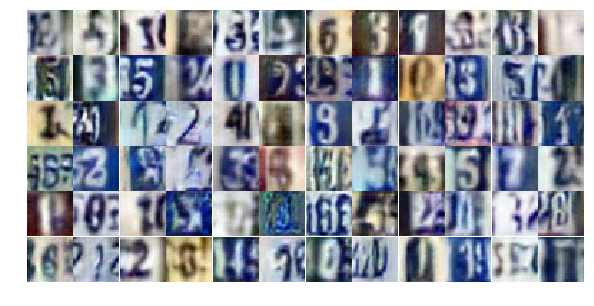

Epoch 14/20... Discriminator Loss: 0.4604... Generator Loss: 1.4244
Epoch 14/20... Discriminator Loss: 1.3237... Generator Loss: 2.9859
Epoch 14/20... Discriminator Loss: 1.2191... Generator Loss: 2.3106
Epoch 14/20... Discriminator Loss: 0.5378... Generator Loss: 1.3442
Epoch 14/20... Discriminator Loss: 0.9512... Generator Loss: 0.8672
Epoch 14/20... Discriminator Loss: 0.9070... Generator Loss: 0.8529
Epoch 14/20... Discriminator Loss: 0.8482... Generator Loss: 0.8728
Epoch 14/20... Discriminator Loss: 0.6722... Generator Loss: 1.1323
Epoch 14/20... Discriminator Loss: 0.6869... Generator Loss: 1.0358
Epoch 14/20... Discriminator Loss: 0.6911... Generator Loss: 1.0035


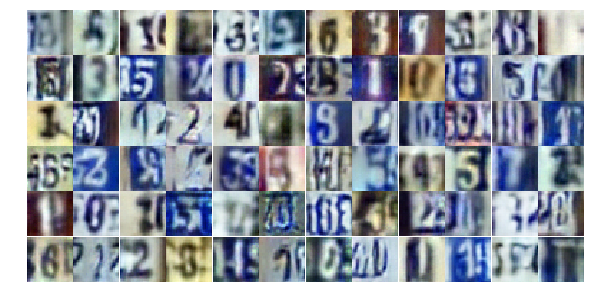

Epoch 14/20... Discriminator Loss: 1.5033... Generator Loss: 0.3541
Epoch 14/20... Discriminator Loss: 0.4404... Generator Loss: 1.4594
Epoch 14/20... Discriminator Loss: 0.5974... Generator Loss: 1.2017
Epoch 14/20... Discriminator Loss: 0.4952... Generator Loss: 1.6186
Epoch 14/20... Discriminator Loss: 0.6893... Generator Loss: 1.2420
Epoch 14/20... Discriminator Loss: 0.8779... Generator Loss: 0.7729
Epoch 14/20... Discriminator Loss: 0.6442... Generator Loss: 1.1409
Epoch 14/20... Discriminator Loss: 0.4702... Generator Loss: 1.5306
Epoch 14/20... Discriminator Loss: 0.4409... Generator Loss: 1.7884
Epoch 14/20... Discriminator Loss: 0.9501... Generator Loss: 0.7698


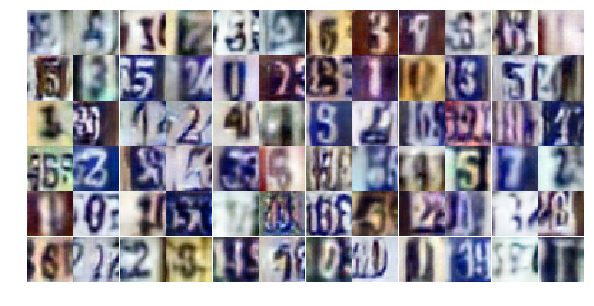

Epoch 14/20... Discriminator Loss: 1.4621... Generator Loss: 0.3681
Epoch 14/20... Discriminator Loss: 0.8223... Generator Loss: 1.3628
Epoch 14/20... Discriminator Loss: 1.0419... Generator Loss: 0.7087
Epoch 14/20... Discriminator Loss: 0.9865... Generator Loss: 0.6202
Epoch 14/20... Discriminator Loss: 1.4414... Generator Loss: 0.3493
Epoch 14/20... Discriminator Loss: 0.7003... Generator Loss: 1.1458
Epoch 14/20... Discriminator Loss: 0.6684... Generator Loss: 1.1416
Epoch 14/20... Discriminator Loss: 0.6647... Generator Loss: 1.2690
Epoch 14/20... Discriminator Loss: 1.2807... Generator Loss: 0.4506
Epoch 14/20... Discriminator Loss: 1.0539... Generator Loss: 0.6998


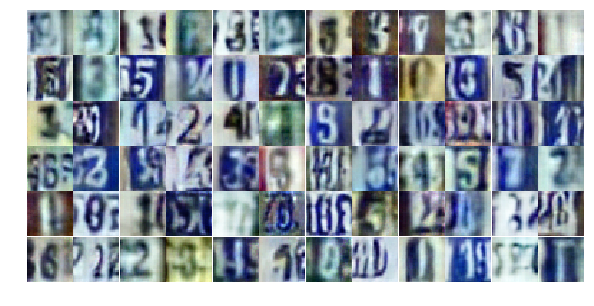

Epoch 14/20... Discriminator Loss: 0.8547... Generator Loss: 1.1736
Epoch 14/20... Discriminator Loss: 1.2125... Generator Loss: 0.4658
Epoch 14/20... Discriminator Loss: 0.5915... Generator Loss: 1.3959
Epoch 14/20... Discriminator Loss: 1.2700... Generator Loss: 0.4497
Epoch 14/20... Discriminator Loss: 0.7031... Generator Loss: 1.1016
Epoch 14/20... Discriminator Loss: 0.6134... Generator Loss: 1.7481
Epoch 14/20... Discriminator Loss: 1.6462... Generator Loss: 3.2570
Epoch 14/20... Discriminator Loss: 0.7485... Generator Loss: 1.2772
Epoch 14/20... Discriminator Loss: 0.9732... Generator Loss: 0.8221
Epoch 14/20... Discriminator Loss: 1.2362... Generator Loss: 0.5079


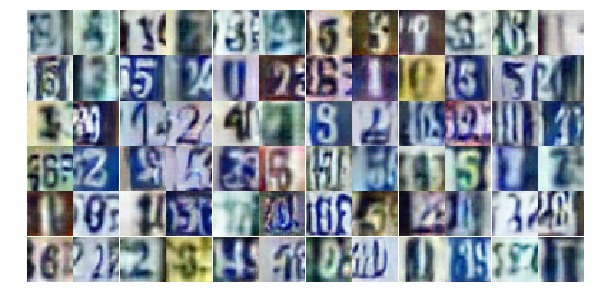

Epoch 14/20... Discriminator Loss: 0.7997... Generator Loss: 1.3251
Epoch 14/20... Discriminator Loss: 0.7611... Generator Loss: 1.0467
Epoch 15/20... Discriminator Loss: 0.6307... Generator Loss: 1.1393
Epoch 15/20... Discriminator Loss: 0.5815... Generator Loss: 1.6278
Epoch 15/20... Discriminator Loss: 0.6210... Generator Loss: 1.3223
Epoch 15/20... Discriminator Loss: 0.8261... Generator Loss: 0.8070
Epoch 15/20... Discriminator Loss: 0.8409... Generator Loss: 0.7431
Epoch 15/20... Discriminator Loss: 0.6600... Generator Loss: 1.4457
Epoch 15/20... Discriminator Loss: 1.6176... Generator Loss: 0.3177
Epoch 15/20... Discriminator Loss: 0.7452... Generator Loss: 0.8885


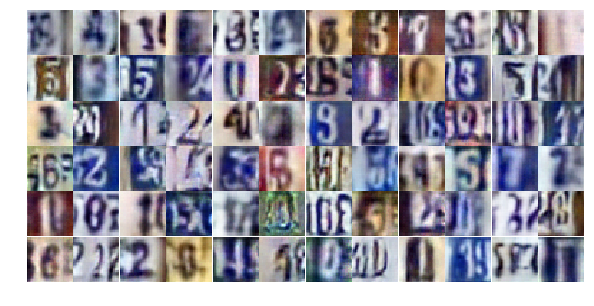

Epoch 15/20... Discriminator Loss: 0.8094... Generator Loss: 0.9473
Epoch 15/20... Discriminator Loss: 0.8511... Generator Loss: 0.8554
Epoch 15/20... Discriminator Loss: 0.9171... Generator Loss: 0.7530
Epoch 15/20... Discriminator Loss: 0.8244... Generator Loss: 0.7729
Epoch 15/20... Discriminator Loss: 0.9997... Generator Loss: 0.7106
Epoch 15/20... Discriminator Loss: 0.6151... Generator Loss: 1.2415
Epoch 15/20... Discriminator Loss: 0.9495... Generator Loss: 0.6908
Epoch 15/20... Discriminator Loss: 0.8584... Generator Loss: 0.9553
Epoch 15/20... Discriminator Loss: 0.8835... Generator Loss: 2.9966
Epoch 15/20... Discriminator Loss: 1.0927... Generator Loss: 0.6818


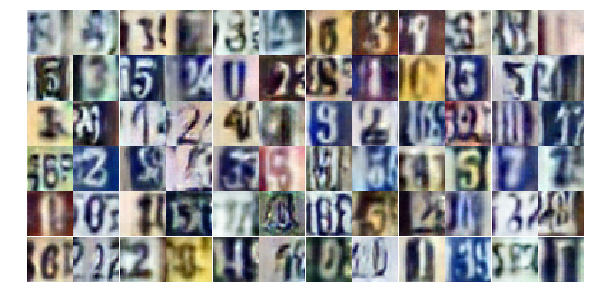

Epoch 15/20... Discriminator Loss: 0.9044... Generator Loss: 0.9190
Epoch 15/20... Discriminator Loss: 0.7213... Generator Loss: 0.9385
Epoch 15/20... Discriminator Loss: 0.6110... Generator Loss: 1.7511
Epoch 15/20... Discriminator Loss: 1.1374... Generator Loss: 0.5416
Epoch 15/20... Discriminator Loss: 1.3400... Generator Loss: 0.4424
Epoch 15/20... Discriminator Loss: 0.6136... Generator Loss: 1.2787
Epoch 15/20... Discriminator Loss: 1.1115... Generator Loss: 0.5896
Epoch 15/20... Discriminator Loss: 1.0288... Generator Loss: 0.6012
Epoch 15/20... Discriminator Loss: 0.6281... Generator Loss: 1.1952
Epoch 15/20... Discriminator Loss: 1.4064... Generator Loss: 0.4065


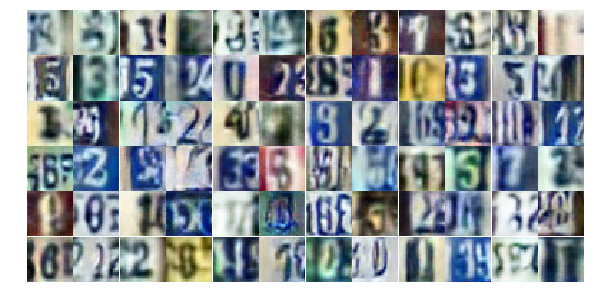

Epoch 15/20... Discriminator Loss: 0.9519... Generator Loss: 0.7280
Epoch 15/20... Discriminator Loss: 1.3167... Generator Loss: 0.4567
Epoch 15/20... Discriminator Loss: 0.5336... Generator Loss: 1.5389
Epoch 15/20... Discriminator Loss: 0.7013... Generator Loss: 1.0472
Epoch 15/20... Discriminator Loss: 0.5547... Generator Loss: 1.2556
Epoch 15/20... Discriminator Loss: 1.1717... Generator Loss: 2.8589
Epoch 15/20... Discriminator Loss: 0.6186... Generator Loss: 1.3589
Epoch 15/20... Discriminator Loss: 0.6587... Generator Loss: 1.5678
Epoch 15/20... Discriminator Loss: 0.6273... Generator Loss: 2.2810
Epoch 15/20... Discriminator Loss: 0.8907... Generator Loss: 0.7559


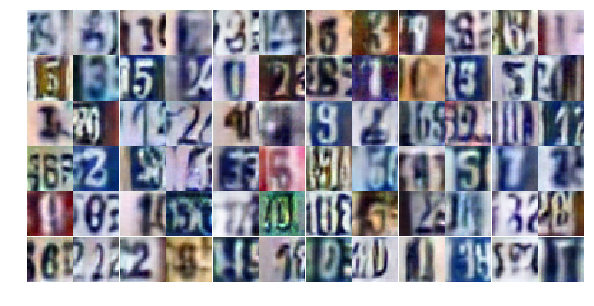

Epoch 15/20... Discriminator Loss: 0.7761... Generator Loss: 0.8388
Epoch 15/20... Discriminator Loss: 1.4882... Generator Loss: 0.3567
Epoch 15/20... Discriminator Loss: 0.7876... Generator Loss: 1.0209
Epoch 15/20... Discriminator Loss: 0.5253... Generator Loss: 1.3356
Epoch 15/20... Discriminator Loss: 0.5811... Generator Loss: 1.2243
Epoch 15/20... Discriminator Loss: 1.7192... Generator Loss: 0.2836
Epoch 15/20... Discriminator Loss: 0.5677... Generator Loss: 1.5409
Epoch 15/20... Discriminator Loss: 0.7895... Generator Loss: 1.5036
Epoch 15/20... Discriminator Loss: 0.7629... Generator Loss: 0.9677
Epoch 15/20... Discriminator Loss: 0.7326... Generator Loss: 1.0162


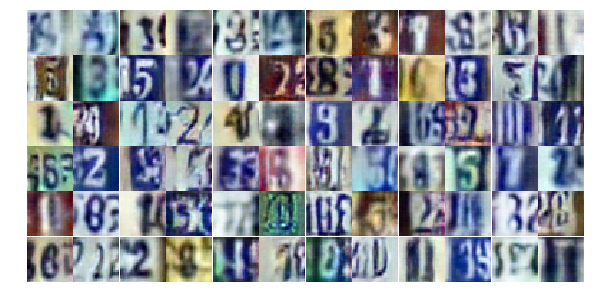

Epoch 15/20... Discriminator Loss: 1.4896... Generator Loss: 0.3602
Epoch 15/20... Discriminator Loss: 1.0348... Generator Loss: 0.7457
Epoch 15/20... Discriminator Loss: 0.6257... Generator Loss: 1.3081
Epoch 15/20... Discriminator Loss: 0.7566... Generator Loss: 0.9567
Epoch 15/20... Discriminator Loss: 0.5254... Generator Loss: 1.7840
Epoch 15/20... Discriminator Loss: 0.6818... Generator Loss: 1.3904
Epoch 15/20... Discriminator Loss: 1.1964... Generator Loss: 0.5145
Epoch 15/20... Discriminator Loss: 0.7888... Generator Loss: 1.3379
Epoch 15/20... Discriminator Loss: 1.0136... Generator Loss: 0.7529
Epoch 16/20... Discriminator Loss: 1.4186... Generator Loss: 0.3730


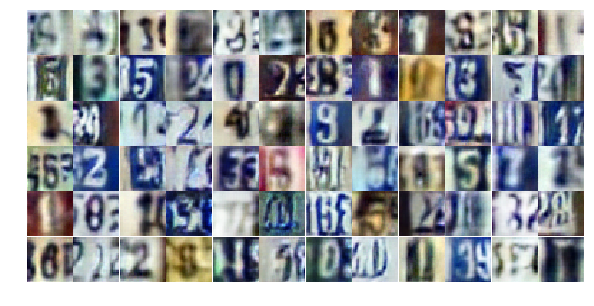

Epoch 16/20... Discriminator Loss: 0.6988... Generator Loss: 0.9637
Epoch 16/20... Discriminator Loss: 0.7621... Generator Loss: 1.3421
Epoch 16/20... Discriminator Loss: 1.1596... Generator Loss: 0.5415
Epoch 16/20... Discriminator Loss: 0.6973... Generator Loss: 1.0406
Epoch 16/20... Discriminator Loss: 0.6213... Generator Loss: 1.3280
Epoch 16/20... Discriminator Loss: 0.6862... Generator Loss: 1.2712
Epoch 16/20... Discriminator Loss: 1.3620... Generator Loss: 0.4110
Epoch 16/20... Discriminator Loss: 0.9035... Generator Loss: 0.7599
Epoch 16/20... Discriminator Loss: 0.9685... Generator Loss: 0.6913
Epoch 16/20... Discriminator Loss: 0.5248... Generator Loss: 1.2117


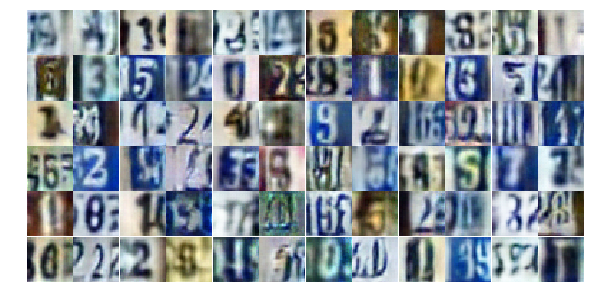

Epoch 16/20... Discriminator Loss: 1.6321... Generator Loss: 0.3343
Epoch 16/20... Discriminator Loss: 0.8449... Generator Loss: 0.9328
Epoch 16/20... Discriminator Loss: 0.8717... Generator Loss: 0.8721
Epoch 16/20... Discriminator Loss: 1.3324... Generator Loss: 0.4115
Epoch 16/20... Discriminator Loss: 0.6269... Generator Loss: 1.6915
Epoch 16/20... Discriminator Loss: 0.6372... Generator Loss: 1.3789
Epoch 16/20... Discriminator Loss: 1.5401... Generator Loss: 0.7609
Epoch 16/20... Discriminator Loss: 0.5749... Generator Loss: 1.7068
Epoch 16/20... Discriminator Loss: 0.6060... Generator Loss: 1.2544
Epoch 16/20... Discriminator Loss: 0.5836... Generator Loss: 1.4219


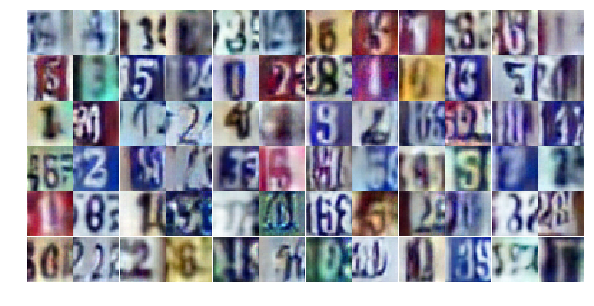

Epoch 16/20... Discriminator Loss: 0.5314... Generator Loss: 1.4782
Epoch 16/20... Discriminator Loss: 0.6374... Generator Loss: 1.2334
Epoch 16/20... Discriminator Loss: 0.7243... Generator Loss: 0.9962
Epoch 16/20... Discriminator Loss: 1.0064... Generator Loss: 0.6286
Epoch 16/20... Discriminator Loss: 0.8476... Generator Loss: 0.8040
Epoch 16/20... Discriminator Loss: 0.9917... Generator Loss: 0.6833
Epoch 16/20... Discriminator Loss: 0.7740... Generator Loss: 0.8589
Epoch 16/20... Discriminator Loss: 0.6206... Generator Loss: 1.2023
Epoch 16/20... Discriminator Loss: 0.8900... Generator Loss: 0.8210
Epoch 16/20... Discriminator Loss: 0.7744... Generator Loss: 0.9452


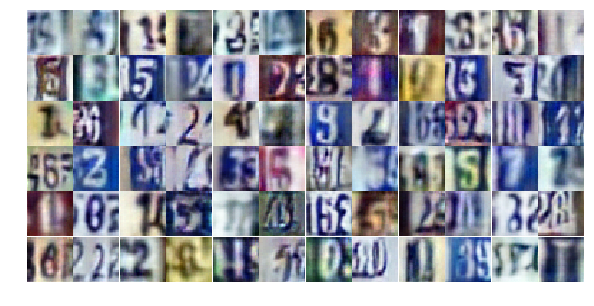

Epoch 16/20... Discriminator Loss: 0.7624... Generator Loss: 0.8563
Epoch 16/20... Discriminator Loss: 0.6968... Generator Loss: 0.9661
Epoch 16/20... Discriminator Loss: 0.8437... Generator Loss: 0.8208
Epoch 16/20... Discriminator Loss: 0.6475... Generator Loss: 1.1806
Epoch 16/20... Discriminator Loss: 1.1052... Generator Loss: 0.5546
Epoch 16/20... Discriminator Loss: 1.3381... Generator Loss: 0.4575
Epoch 16/20... Discriminator Loss: 0.6709... Generator Loss: 1.0092
Epoch 16/20... Discriminator Loss: 1.3933... Generator Loss: 0.3878
Epoch 16/20... Discriminator Loss: 1.1457... Generator Loss: 0.5322
Epoch 16/20... Discriminator Loss: 0.6660... Generator Loss: 1.6912


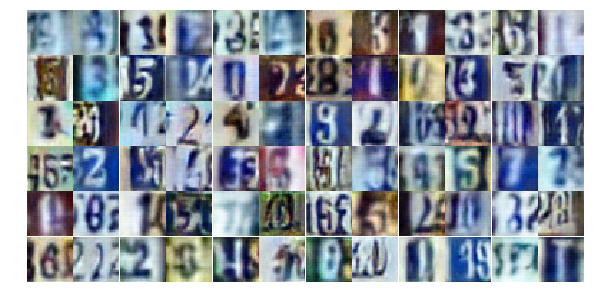

Epoch 16/20... Discriminator Loss: 0.6720... Generator Loss: 1.0308
Epoch 16/20... Discriminator Loss: 0.6504... Generator Loss: 1.4047
Epoch 16/20... Discriminator Loss: 0.9226... Generator Loss: 0.6734
Epoch 16/20... Discriminator Loss: 0.7209... Generator Loss: 1.4599
Epoch 16/20... Discriminator Loss: 0.7100... Generator Loss: 1.0504
Epoch 16/20... Discriminator Loss: 1.0455... Generator Loss: 0.5978
Epoch 16/20... Discriminator Loss: 0.6262... Generator Loss: 1.2160
Epoch 16/20... Discriminator Loss: 0.8786... Generator Loss: 0.7572
Epoch 16/20... Discriminator Loss: 0.5214... Generator Loss: 1.3665
Epoch 16/20... Discriminator Loss: 1.0211... Generator Loss: 0.7175


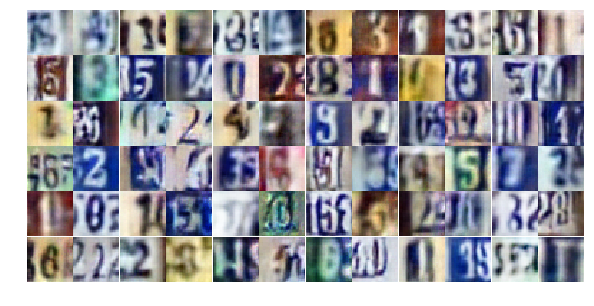

Epoch 16/20... Discriminator Loss: 0.8923... Generator Loss: 0.8264
Epoch 16/20... Discriminator Loss: 0.6353... Generator Loss: 1.1959
Epoch 16/20... Discriminator Loss: 1.4637... Generator Loss: 0.3740
Epoch 16/20... Discriminator Loss: 0.6439... Generator Loss: 2.1518
Epoch 16/20... Discriminator Loss: 0.5493... Generator Loss: 1.3958
Epoch 16/20... Discriminator Loss: 1.1799... Generator Loss: 3.2375
Epoch 17/20... Discriminator Loss: 0.6943... Generator Loss: 1.0799
Epoch 17/20... Discriminator Loss: 0.8726... Generator Loss: 0.7781
Epoch 17/20... Discriminator Loss: 0.5999... Generator Loss: 2.2182
Epoch 17/20... Discriminator Loss: 1.2758... Generator Loss: 0.4794


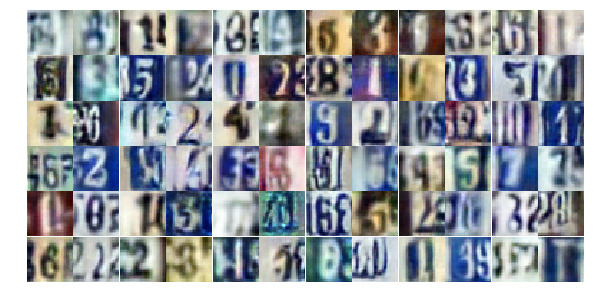

Epoch 17/20... Discriminator Loss: 0.5028... Generator Loss: 1.4544
Epoch 17/20... Discriminator Loss: 0.6073... Generator Loss: 1.1017
Epoch 17/20... Discriminator Loss: 0.9779... Generator Loss: 0.7635
Epoch 17/20... Discriminator Loss: 0.8468... Generator Loss: 0.8272
Epoch 17/20... Discriminator Loss: 1.0860... Generator Loss: 0.5954
Epoch 17/20... Discriminator Loss: 0.8896... Generator Loss: 0.8290
Epoch 17/20... Discriminator Loss: 0.8498... Generator Loss: 0.8320
Epoch 17/20... Discriminator Loss: 0.5422... Generator Loss: 1.6028
Epoch 17/20... Discriminator Loss: 0.4734... Generator Loss: 1.4036
Epoch 17/20... Discriminator Loss: 0.8795... Generator Loss: 1.3660


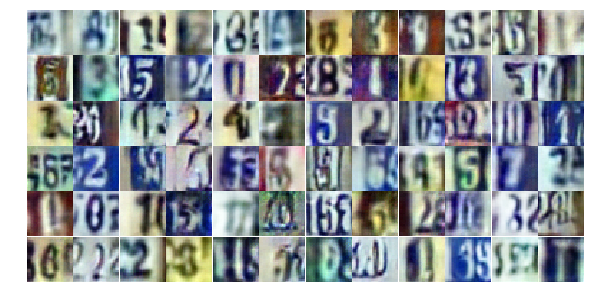

Epoch 17/20... Discriminator Loss: 0.7703... Generator Loss: 1.3962
Epoch 17/20... Discriminator Loss: 0.7544... Generator Loss: 0.8453
Epoch 17/20... Discriminator Loss: 0.6710... Generator Loss: 1.0173
Epoch 17/20... Discriminator Loss: 1.9393... Generator Loss: 0.3535
Epoch 17/20... Discriminator Loss: 1.6899... Generator Loss: 0.5498
Epoch 17/20... Discriminator Loss: 0.7871... Generator Loss: 0.9963
Epoch 17/20... Discriminator Loss: 0.6266... Generator Loss: 1.3949
Epoch 17/20... Discriminator Loss: 0.6932... Generator Loss: 1.1909
Epoch 17/20... Discriminator Loss: 0.7019... Generator Loss: 1.1274
Epoch 17/20... Discriminator Loss: 0.6739... Generator Loss: 1.0172


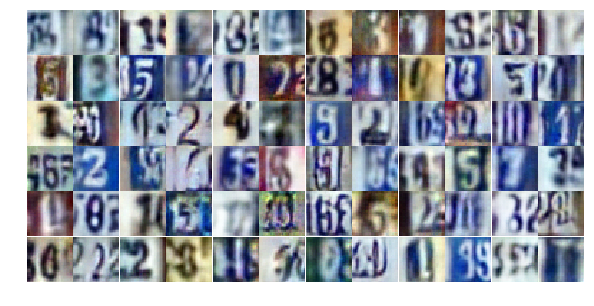

Epoch 17/20... Discriminator Loss: 1.1196... Generator Loss: 0.5889
Epoch 17/20... Discriminator Loss: 0.6926... Generator Loss: 1.1009
Epoch 17/20... Discriminator Loss: 0.6095... Generator Loss: 1.1733
Epoch 17/20... Discriminator Loss: 1.1855... Generator Loss: 0.4972
Epoch 17/20... Discriminator Loss: 1.1579... Generator Loss: 0.5731
Epoch 17/20... Discriminator Loss: 0.5065... Generator Loss: 1.4582
Epoch 17/20... Discriminator Loss: 0.7795... Generator Loss: 0.9086
Epoch 17/20... Discriminator Loss: 0.9475... Generator Loss: 0.6851
Epoch 17/20... Discriminator Loss: 0.8625... Generator Loss: 0.8911
Epoch 17/20... Discriminator Loss: 0.5672... Generator Loss: 1.2917


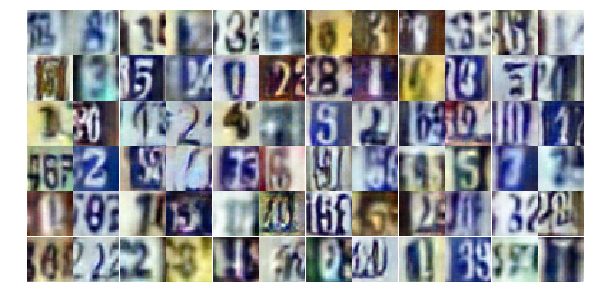

Epoch 17/20... Discriminator Loss: 0.9440... Generator Loss: 0.9064
Epoch 17/20... Discriminator Loss: 1.0609... Generator Loss: 0.7251
Epoch 17/20... Discriminator Loss: 0.6723... Generator Loss: 1.5624
Epoch 17/20... Discriminator Loss: 0.8594... Generator Loss: 0.8362
Epoch 17/20... Discriminator Loss: 1.4460... Generator Loss: 0.3585
Epoch 17/20... Discriminator Loss: 0.6111... Generator Loss: 1.2640
Epoch 17/20... Discriminator Loss: 1.1181... Generator Loss: 0.5478
Epoch 17/20... Discriminator Loss: 0.4940... Generator Loss: 1.4840
Epoch 17/20... Discriminator Loss: 0.4262... Generator Loss: 1.9334
Epoch 17/20... Discriminator Loss: 0.9300... Generator Loss: 0.7254


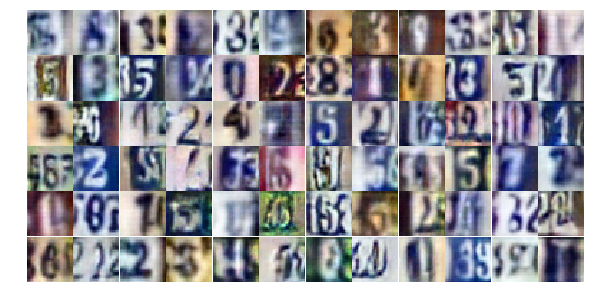

Epoch 17/20... Discriminator Loss: 1.1141... Generator Loss: 0.8171
Epoch 17/20... Discriminator Loss: 0.4552... Generator Loss: 1.9881
Epoch 17/20... Discriminator Loss: 0.8942... Generator Loss: 0.9181
Epoch 17/20... Discriminator Loss: 0.6162... Generator Loss: 1.1465
Epoch 17/20... Discriminator Loss: 0.7279... Generator Loss: 1.0041
Epoch 17/20... Discriminator Loss: 1.0289... Generator Loss: 0.6244
Epoch 17/20... Discriminator Loss: 0.9440... Generator Loss: 0.7181
Epoch 17/20... Discriminator Loss: 0.6645... Generator Loss: 1.1674
Epoch 17/20... Discriminator Loss: 0.6337... Generator Loss: 1.2377
Epoch 17/20... Discriminator Loss: 1.5539... Generator Loss: 0.3431


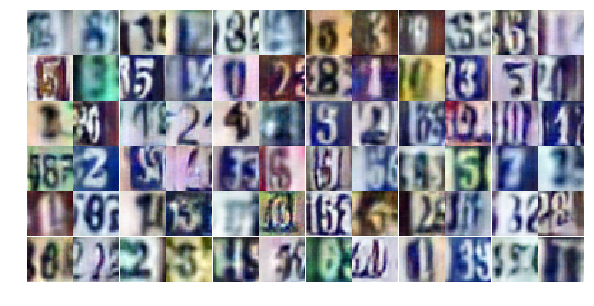

Epoch 17/20... Discriminator Loss: 0.7199... Generator Loss: 1.1589
Epoch 17/20... Discriminator Loss: 0.8177... Generator Loss: 1.1586
Epoch 17/20... Discriminator Loss: 1.0650... Generator Loss: 0.6316
Epoch 17/20... Discriminator Loss: 0.8062... Generator Loss: 1.0741
Epoch 18/20... Discriminator Loss: 1.1314... Generator Loss: 0.5634
Epoch 18/20... Discriminator Loss: 1.0739... Generator Loss: 0.5386
Epoch 18/20... Discriminator Loss: 0.6939... Generator Loss: 1.1127
Epoch 18/20... Discriminator Loss: 0.6997... Generator Loss: 1.1029
Epoch 18/20... Discriminator Loss: 0.9007... Generator Loss: 0.7584
Epoch 18/20... Discriminator Loss: 0.6908... Generator Loss: 1.3961


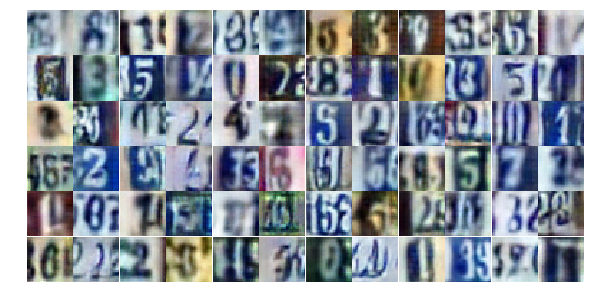

Epoch 18/20... Discriminator Loss: 0.5663... Generator Loss: 2.2319
Epoch 18/20... Discriminator Loss: 1.0762... Generator Loss: 0.6208
Epoch 18/20... Discriminator Loss: 0.8651... Generator Loss: 0.8608
Epoch 18/20... Discriminator Loss: 0.4109... Generator Loss: 1.7207
Epoch 18/20... Discriminator Loss: 0.6031... Generator Loss: 1.4361
Epoch 18/20... Discriminator Loss: 0.9915... Generator Loss: 0.6985
Epoch 18/20... Discriminator Loss: 0.6889... Generator Loss: 1.0270
Epoch 18/20... Discriminator Loss: 0.9242... Generator Loss: 0.7272
Epoch 18/20... Discriminator Loss: 0.7110... Generator Loss: 1.8937
Epoch 18/20... Discriminator Loss: 0.4865... Generator Loss: 3.2131


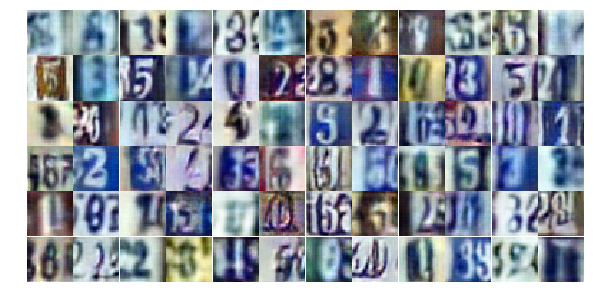

Epoch 18/20... Discriminator Loss: 1.0856... Generator Loss: 0.7925
Epoch 18/20... Discriminator Loss: 0.7034... Generator Loss: 1.5703
Epoch 18/20... Discriminator Loss: 0.8855... Generator Loss: 0.7920
Epoch 18/20... Discriminator Loss: 0.6151... Generator Loss: 1.4278
Epoch 18/20... Discriminator Loss: 0.9471... Generator Loss: 0.7132
Epoch 18/20... Discriminator Loss: 0.6534... Generator Loss: 1.7589
Epoch 18/20... Discriminator Loss: 1.1434... Generator Loss: 0.7782
Epoch 18/20... Discriminator Loss: 1.0568... Generator Loss: 0.6688
Epoch 18/20... Discriminator Loss: 0.7035... Generator Loss: 1.0062
Epoch 18/20... Discriminator Loss: 0.6410... Generator Loss: 1.0865


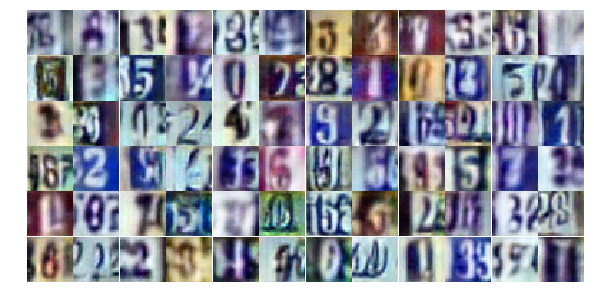

Epoch 18/20... Discriminator Loss: 0.5255... Generator Loss: 1.3951
Epoch 18/20... Discriminator Loss: 0.8447... Generator Loss: 1.3387
Epoch 18/20... Discriminator Loss: 0.6620... Generator Loss: 1.2297
Epoch 18/20... Discriminator Loss: 0.8047... Generator Loss: 1.0323
Epoch 18/20... Discriminator Loss: 0.9412... Generator Loss: 0.7162
Epoch 18/20... Discriminator Loss: 0.9663... Generator Loss: 0.7405
Epoch 18/20... Discriminator Loss: 0.7882... Generator Loss: 1.0177
Epoch 18/20... Discriminator Loss: 0.8256... Generator Loss: 0.9031
Epoch 18/20... Discriminator Loss: 0.8417... Generator Loss: 0.8126
Epoch 18/20... Discriminator Loss: 0.8781... Generator Loss: 1.0287


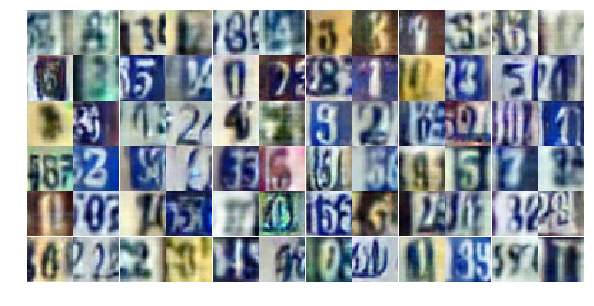

Epoch 18/20... Discriminator Loss: 0.6182... Generator Loss: 1.1366
Epoch 18/20... Discriminator Loss: 0.6885... Generator Loss: 1.0785
Epoch 18/20... Discriminator Loss: 0.6419... Generator Loss: 1.0753
Epoch 18/20... Discriminator Loss: 0.6930... Generator Loss: 0.9831
Epoch 18/20... Discriminator Loss: 1.0142... Generator Loss: 0.6904
Epoch 18/20... Discriminator Loss: 0.5668... Generator Loss: 1.2314
Epoch 18/20... Discriminator Loss: 0.6183... Generator Loss: 1.2061
Epoch 18/20... Discriminator Loss: 0.9606... Generator Loss: 1.3808
Epoch 18/20... Discriminator Loss: 0.5557... Generator Loss: 1.8036
Epoch 18/20... Discriminator Loss: 0.4147... Generator Loss: 1.7581


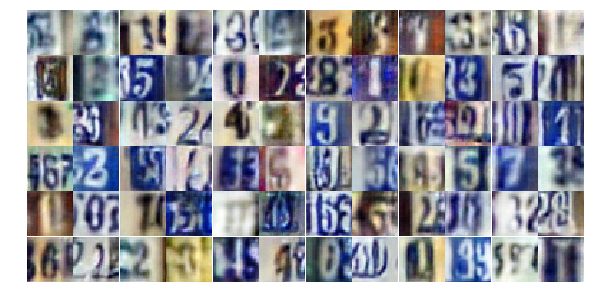

Epoch 18/20... Discriminator Loss: 0.5390... Generator Loss: 1.2971
Epoch 18/20... Discriminator Loss: 0.7500... Generator Loss: 1.0287
Epoch 18/20... Discriminator Loss: 0.7799... Generator Loss: 2.2874
Epoch 18/20... Discriminator Loss: 0.7505... Generator Loss: 1.1871
Epoch 18/20... Discriminator Loss: 0.5350... Generator Loss: 1.3571
Epoch 18/20... Discriminator Loss: 0.5680... Generator Loss: 2.1334
Epoch 18/20... Discriminator Loss: 0.7346... Generator Loss: 1.0036
Epoch 18/20... Discriminator Loss: 0.5398... Generator Loss: 1.5444
Epoch 18/20... Discriminator Loss: 0.9015... Generator Loss: 0.9338
Epoch 18/20... Discriminator Loss: 0.5236... Generator Loss: 1.3677


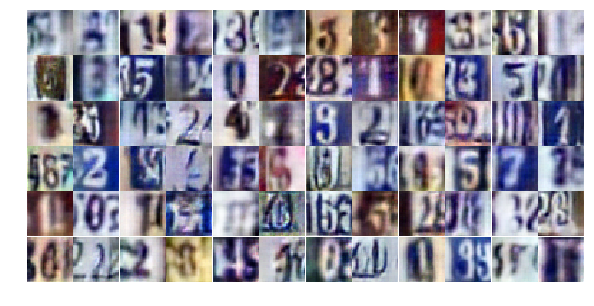

Epoch 18/20... Discriminator Loss: 0.6533... Generator Loss: 1.8770
Epoch 19/20... Discriminator Loss: 0.9450... Generator Loss: 0.7991
Epoch 19/20... Discriminator Loss: 1.0524... Generator Loss: 0.6477
Epoch 19/20... Discriminator Loss: 0.8291... Generator Loss: 0.8495
Epoch 19/20... Discriminator Loss: 0.6592... Generator Loss: 1.2585
Epoch 19/20... Discriminator Loss: 1.0544... Generator Loss: 0.6474
Epoch 19/20... Discriminator Loss: 0.5880... Generator Loss: 1.1779
Epoch 19/20... Discriminator Loss: 0.8732... Generator Loss: 0.7793
Epoch 19/20... Discriminator Loss: 0.6684... Generator Loss: 1.3096
Epoch 19/20... Discriminator Loss: 0.8624... Generator Loss: 0.8857


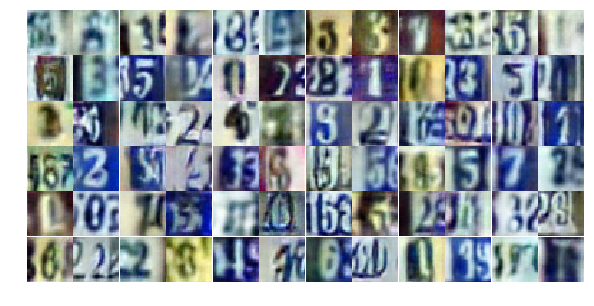

Epoch 19/20... Discriminator Loss: 0.7834... Generator Loss: 0.8733
Epoch 19/20... Discriminator Loss: 0.9902... Generator Loss: 0.6602
Epoch 19/20... Discriminator Loss: 0.7806... Generator Loss: 0.9351
Epoch 19/20... Discriminator Loss: 0.9681... Generator Loss: 0.6324
Epoch 19/20... Discriminator Loss: 1.0882... Generator Loss: 0.5756
Epoch 19/20... Discriminator Loss: 0.5165... Generator Loss: 1.4455
Epoch 19/20... Discriminator Loss: 1.5072... Generator Loss: 0.3852
Epoch 19/20... Discriminator Loss: 0.7766... Generator Loss: 0.8978
Epoch 19/20... Discriminator Loss: 0.7686... Generator Loss: 1.0426
Epoch 19/20... Discriminator Loss: 1.2286... Generator Loss: 0.5437


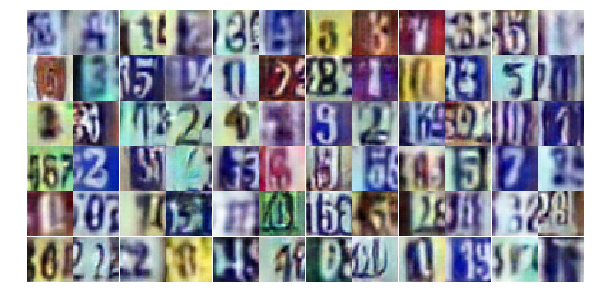

Epoch 19/20... Discriminator Loss: 0.9202... Generator Loss: 0.7244
Epoch 19/20... Discriminator Loss: 1.4117... Generator Loss: 0.3861
Epoch 19/20... Discriminator Loss: 1.5353... Generator Loss: 0.3277
Epoch 19/20... Discriminator Loss: 0.9873... Generator Loss: 0.7787
Epoch 19/20... Discriminator Loss: 1.0502... Generator Loss: 0.6585
Epoch 19/20... Discriminator Loss: 0.9234... Generator Loss: 0.8800
Epoch 19/20... Discriminator Loss: 0.6887... Generator Loss: 1.1686
Epoch 19/20... Discriminator Loss: 0.4862... Generator Loss: 1.6466
Epoch 19/20... Discriminator Loss: 0.5171... Generator Loss: 1.5382
Epoch 19/20... Discriminator Loss: 0.8598... Generator Loss: 0.8657


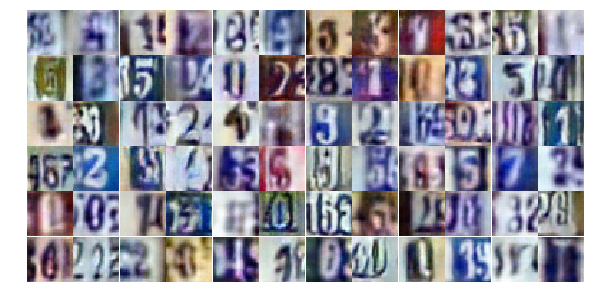

Epoch 19/20... Discriminator Loss: 0.9564... Generator Loss: 0.7060
Epoch 19/20... Discriminator Loss: 0.8680... Generator Loss: 0.7643
Epoch 19/20... Discriminator Loss: 0.9210... Generator Loss: 0.7119
Epoch 19/20... Discriminator Loss: 0.5439... Generator Loss: 1.2622
Epoch 19/20... Discriminator Loss: 0.6741... Generator Loss: 1.0434
Epoch 19/20... Discriminator Loss: 1.7452... Generator Loss: 0.2616
Epoch 19/20... Discriminator Loss: 1.0843... Generator Loss: 0.7194
Epoch 19/20... Discriminator Loss: 0.6519... Generator Loss: 1.6460
Epoch 19/20... Discriminator Loss: 0.8574... Generator Loss: 0.9033
Epoch 19/20... Discriminator Loss: 0.6647... Generator Loss: 1.0423


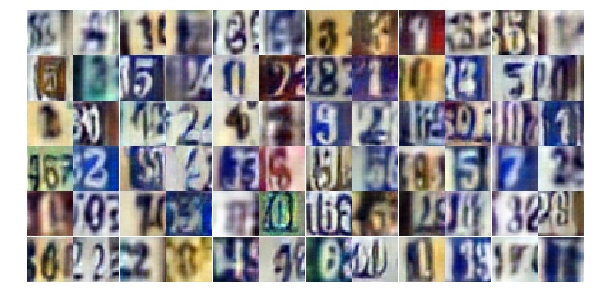

Epoch 19/20... Discriminator Loss: 0.6788... Generator Loss: 0.9649
Epoch 19/20... Discriminator Loss: 0.7874... Generator Loss: 1.1624
Epoch 19/20... Discriminator Loss: 1.1571... Generator Loss: 0.5441
Epoch 19/20... Discriminator Loss: 0.7024... Generator Loss: 1.1275
Epoch 19/20... Discriminator Loss: 0.7970... Generator Loss: 0.8740
Epoch 19/20... Discriminator Loss: 1.2747... Generator Loss: 3.9378
Epoch 19/20... Discriminator Loss: 0.7432... Generator Loss: 1.2242
Epoch 19/20... Discriminator Loss: 0.5990... Generator Loss: 1.4068
Epoch 19/20... Discriminator Loss: 0.7164... Generator Loss: 1.2623
Epoch 19/20... Discriminator Loss: 0.7820... Generator Loss: 0.8923


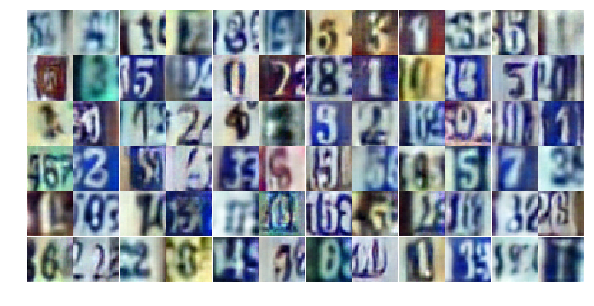

Epoch 19/20... Discriminator Loss: 0.9717... Generator Loss: 0.7259
Epoch 19/20... Discriminator Loss: 0.6904... Generator Loss: 1.1009
Epoch 19/20... Discriminator Loss: 0.7324... Generator Loss: 1.1589
Epoch 19/20... Discriminator Loss: 0.9322... Generator Loss: 0.6942
Epoch 19/20... Discriminator Loss: 0.6512... Generator Loss: 1.1027
Epoch 19/20... Discriminator Loss: 0.7482... Generator Loss: 0.9395
Epoch 19/20... Discriminator Loss: 1.7970... Generator Loss: 0.2701
Epoch 19/20... Discriminator Loss: 0.9879... Generator Loss: 0.6676
Epoch 20/20... Discriminator Loss: 0.7132... Generator Loss: 1.1874
Epoch 20/20... Discriminator Loss: 0.7864... Generator Loss: 1.1141


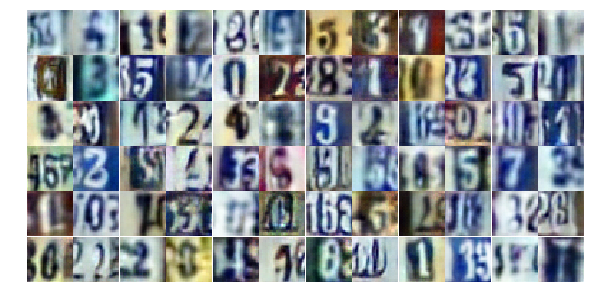

Epoch 20/20... Discriminator Loss: 0.6245... Generator Loss: 1.1878
Epoch 20/20... Discriminator Loss: 1.1601... Generator Loss: 0.5530
Epoch 20/20... Discriminator Loss: 1.3231... Generator Loss: 0.4365
Epoch 20/20... Discriminator Loss: 0.9600... Generator Loss: 0.8689
Epoch 20/20... Discriminator Loss: 0.6569... Generator Loss: 1.0179
Epoch 20/20... Discriminator Loss: 0.7730... Generator Loss: 0.9302
Epoch 20/20... Discriminator Loss: 0.8532... Generator Loss: 0.9171
Epoch 20/20... Discriminator Loss: 0.7042... Generator Loss: 1.3948
Epoch 20/20... Discriminator Loss: 0.9805... Generator Loss: 0.8259
Epoch 20/20... Discriminator Loss: 0.8410... Generator Loss: 0.7183


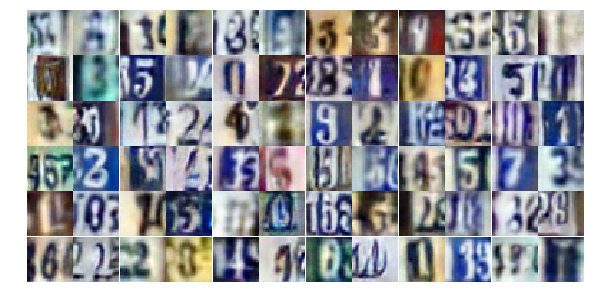

Epoch 20/20... Discriminator Loss: 1.0830... Generator Loss: 0.5861
Epoch 20/20... Discriminator Loss: 1.0222... Generator Loss: 0.6494
Epoch 20/20... Discriminator Loss: 0.7104... Generator Loss: 1.1471
Epoch 20/20... Discriminator Loss: 0.8704... Generator Loss: 0.9004
Epoch 20/20... Discriminator Loss: 0.9066... Generator Loss: 0.7797
Epoch 20/20... Discriminator Loss: 0.9786... Generator Loss: 1.8287
Epoch 20/20... Discriminator Loss: 0.7518... Generator Loss: 1.0313
Epoch 20/20... Discriminator Loss: 0.6333... Generator Loss: 1.1656
Epoch 20/20... Discriminator Loss: 0.7399... Generator Loss: 0.9545
Epoch 20/20... Discriminator Loss: 1.1043... Generator Loss: 0.5353


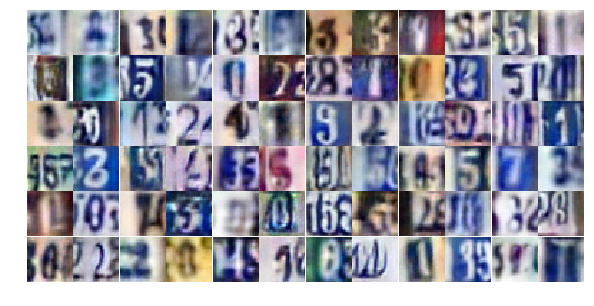

Epoch 20/20... Discriminator Loss: 0.6478... Generator Loss: 1.0882
Epoch 20/20... Discriminator Loss: 0.9078... Generator Loss: 0.7356
Epoch 20/20... Discriminator Loss: 0.3170... Generator Loss: 2.7762
Epoch 20/20... Discriminator Loss: 1.2061... Generator Loss: 0.5607
Epoch 20/20... Discriminator Loss: 0.8239... Generator Loss: 0.9640
Epoch 20/20... Discriminator Loss: 0.4990... Generator Loss: 1.5604
Epoch 20/20... Discriminator Loss: 0.5610... Generator Loss: 1.7058
Epoch 20/20... Discriminator Loss: 1.4464... Generator Loss: 0.3688
Epoch 20/20... Discriminator Loss: 0.9137... Generator Loss: 0.8078
Epoch 20/20... Discriminator Loss: 0.6953... Generator Loss: 0.9756


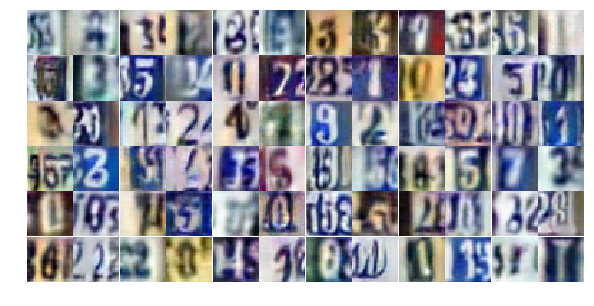

Epoch 20/20... Discriminator Loss: 0.7133... Generator Loss: 1.0353
Epoch 20/20... Discriminator Loss: 0.7542... Generator Loss: 0.9199
Epoch 20/20... Discriminator Loss: 1.1113... Generator Loss: 0.6212
Epoch 20/20... Discriminator Loss: 0.7960... Generator Loss: 1.0242
Epoch 20/20... Discriminator Loss: 1.0599... Generator Loss: 0.8411
Epoch 20/20... Discriminator Loss: 0.5747... Generator Loss: 1.3369
Epoch 20/20... Discriminator Loss: 0.7273... Generator Loss: 1.1943
Epoch 20/20... Discriminator Loss: 0.7478... Generator Loss: 1.0632
Epoch 20/20... Discriminator Loss: 0.8301... Generator Loss: 0.9816
Epoch 20/20... Discriminator Loss: 0.8642... Generator Loss: 0.8370


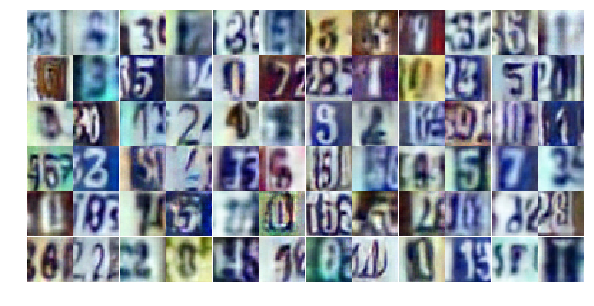

Epoch 20/20... Discriminator Loss: 1.5783... Generator Loss: 0.3600
Epoch 20/20... Discriminator Loss: 0.8907... Generator Loss: 0.8625
Epoch 20/20... Discriminator Loss: 0.6826... Generator Loss: 1.0319
Epoch 20/20... Discriminator Loss: 0.8599... Generator Loss: 0.7868
Epoch 20/20... Discriminator Loss: 0.8264... Generator Loss: 0.9465
Epoch 20/20... Discriminator Loss: 0.9160... Generator Loss: 0.7437
Epoch 20/20... Discriminator Loss: 1.0627... Generator Loss: 0.6422
Epoch 20/20... Discriminator Loss: 0.6048... Generator Loss: 1.5197
Epoch 20/20... Discriminator Loss: 1.2688... Generator Loss: 3.3500
Epoch 20/20... Discriminator Loss: 0.7843... Generator Loss: 0.9438


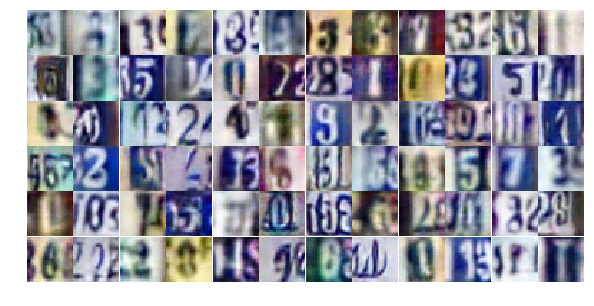

Epoch 20/20... Discriminator Loss: 0.6841... Generator Loss: 1.1267
Epoch 20/20... Discriminator Loss: 1.0189... Generator Loss: 0.6553
Epoch 20/20... Discriminator Loss: 0.5852... Generator Loss: 1.4650
Epoch 20/20... Discriminator Loss: 0.7501... Generator Loss: 1.0914
Epoch 20/20... Discriminator Loss: 4.7268... Generator Loss: 0.0808
Epoch 20/20... Discriminator Loss: 0.8406... Generator Loss: 1.0954


In [34]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

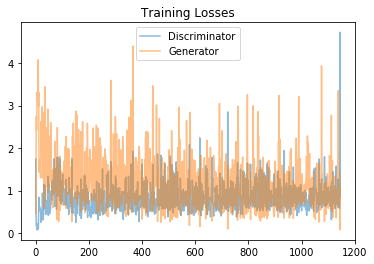

In [35]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

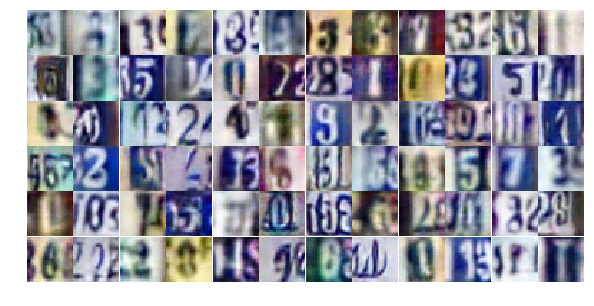

In [36]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))